# 1. Data Import and Setup

This section imports all necessary libraries for machine learning, data analysis, and visualization. It loads the preprocessed dataset containing muscle activation and force measurements.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.preprocessing import PolynomialFeatures, RobustScaler
from sklearn.svm import SVR
from sklearn.multioutput import MultiOutputRegressor
from sklearn.feature_selection import SelectKBest, f_regression
from sklearn.model_selection import GridSearchCV
import xgboost as xgb
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense, Dropout
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.optimizers import Adam
from sklearn.metrics import mean_squared_error, r2_score
from sklearn.ensemble import ExtraTreesRegressor, HistGradientBoostingRegressor, GradientBoostingRegressor, RandomForestRegressor
from sklearn.neural_network import MLPRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from xgboost import XGBRegressor
from keras.wrappers.scikit_learn import KerasRegressor
from tqdm import tqdm
from joblib import parallel_backend  # Import joblib for better parallelism control

# Load the merged dataframe
merged_df = pd.read_csv('merged_df_timefreq.csv')

In [2]:
merged_df

,aDEL,pDEL,lBIC,sBIC,lTRI,BRA,mPEC,force_x,force_y,force_magnitude,...,BRA_total_power,BRA_band_0_0.5_power,BRA_band_2_5_power,BRA_band_5_10_power,BRA_spectral_entropy,mPEC_total_power,mPEC_band_0_0.5_power,mPEC_band_2_5_power,mPEC_band_5_10_power,mPEC_spectral_entropy
0,0.001888,0.000620,0.000958,0.000576,0.002296,0.000151,-0.000159,-0.865295,0.283107,0.910431,...,0.004965,0.003346,0.001207,0.000306,2.116997,0.001075,0.000776,0.000253,0.000042,2.270882
1,0.002324,0.001944,0.002574,0.002020,0.004190,0.002882,0.001318,-0.831443,0.264498,0.872500,...,0.004768,0.003165,0.001176,0.000304,2.137971,0.001077,0.000762,0.000261,0.000048,2.298078
2,0.002735,0.003035,0.003816,0.003284,0.005493,0.004737,0.002525,-0.783037,0.260409,0.825203,...,0.004536,0.002976,0.001133,0.000294,2.154688,0.001073,0.000744,0.000266,0.000053,2.326845
3,0.003034,0.003735,0.004578,0.004258,0.006156,0.005663,0.003337,-0.728060,0.209347,0.757560,...,0.004275,0.002785,0.001078,0.000279,2.164523,0.001056,0.000721,0.000265,0.000055,2.355470
4,0.003179,0.004029,0.004870,0.004908,0.006307,0.005854,0.003741,-0.669814,0.182252,0.694166,...,0.004001,0.002600,0.001013,0.000264,2.165970,0.001024,0.000692,0.000258,0.000055,2.380250
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
20482,0.005416,0.004015,0.010215,0.034421,0.005422,0.029288,0.024821,-24.452561,0.910572,24.469510,...,0.007376,0.005494,0.001656,0.000163,2.546988,0.003264,0.002440,0.000715,0.000083,2.572855
20483,0.005641,0.003727,0.009920,0.035218,0.005448,0.031243,0.023755,-24.460075,0.761295,24.471919,...,0.007362,0.005495,0.001643,0.000166,2.539036,0.003315,0.002455,0.000748,0.000088,2.581148
20484,0.005725,0.003553,0.009581,0.035411,0.005452,0.032225,0.022884,-24.752925,0.476964,24.757520,...,0.007373,0.005506,0.001636,0.000178,2.538610,0.003361,0.002470,0.000778,0.000091,2.589385
20485,0.005732,0.003472,0.009349,0.035343,0.005447,0.032543,0.022374,-24.927267,0.339886,24.929585,...,0.007401,0.005524,0.001633,0.000192,2.544348,0.003397,0.002483,0.000798,0.000093,2.596337


# 2. Data Preparation Pipeline

 This function prepares training and testing datasets by separating data based on repetition number. It optionally performs polynomial feature expansion and feature selection to improve model performance.

Polynomial features significantly increase the feature space but could lead to overfitting. Feature selection using SelectKBest helps identify the most predictive features, reducing dimensionality while preserving important relationships.

In [3]:
# Define root mean squared error function
def root_mean_squared_error(y_true, y_pred):
    return np.sqrt(mean_squared_error(y_true, y_pred))

def prepare_data(use_poly=True, k=100):
    repetitions = merged_df['repetition'].unique()
    last_rep = repetitions.max()

    X_train = merged_df[merged_df['repetition'] != last_rep].drop(["force_x", "force_y", "repetition", "force_magnitude"], axis=1)
    X_test = merged_df[merged_df['repetition'] == last_rep].drop(["force_x", "force_y", "repetition", "force_magnitude"], axis=1)
    y_train = merged_df[merged_df['repetition'] != last_rep][["force_x", "force_y"]]
    y_test = merged_df[merged_df['repetition'] == last_rep][["force_x", "force_y"]]

    X_train = X_train.drop("direction", axis=1)
    X_test = X_test.drop("direction", axis=1)

    if not use_poly:
        scaler = RobustScaler()
        X_train_scaled = scaler.fit_transform(X_train)
        X_test_scaled = scaler.transform(X_test)
        return X_train_scaled, X_test_scaled, y_train, y_test

    poly = PolynomialFeatures(degree=2, include_bias=False)
    X_train_poly = poly.fit_transform(X_train)
    X_test_poly = poly.transform(X_test)

    selector_x = SelectKBest(score_func=f_regression, k=k)
    selector_y = SelectKBest(score_func=f_regression, k=k)
    selected_indices_x = selector_x.fit(X_train_poly, y_train['force_x']).get_support(indices=True)
    selected_indices_y = selector_y.fit(X_train_poly, y_train['force_y']).get_support(indices=True)
    combined_indices = np.union1d(selected_indices_x, selected_indices_y)

    X_train_selected = X_train_poly[:, combined_indices]
    X_test_selected = X_test_poly[:, combined_indices]

    scaler = RobustScaler()
    X_train_scaled = scaler.fit_transform(X_train_selected)
    X_test_scaled = scaler.transform(X_test_selected)
    return X_train_scaled, X_test_scaled, y_train, y_test

X_train_poly, X_test_poly, y_train, y_test = prepare_data(use_poly=True, k=100)
X_train, X_test, y_train, y_test = prepare_data(use_poly=False)

Utility function to reconvert to dataframe

In [4]:
def convert_to_dataframe(X_scaled, original_df, selected_columns=None, is_poly=False):
    """
    Convert scaled or selected data back into a DataFrame with correct column names.
    
    Parameters:
    - X_scaled: Scaled or transformed features after scaling.
    - original_df: Original dataframe used for training (to extract column names).
    - selected_columns: Column names or indices to use (if None, extracts from prepare_data function)
    - is_poly: Boolean indicating if the data includes polynomial features.

    Returns:
    - DataFrame with correct column names.
    """
    # Convert numpy array to DataFrame if needed
    if isinstance(X_scaled, np.ndarray):
        if is_poly and selected_columns is not None:
            # For polynomial features, use 'poly_' prefix for the columns
            poly_columns = [f"poly_{i}" for i in selected_columns]
            return pd.DataFrame(X_scaled, columns=poly_columns)
        else:
            # Get the feature columns from merged_df, excluding target variables
            feature_cols = [col for col in merged_df.columns if col not in ["force_x", "force_y", "repetition", "force_magnitude", "direction"]]
            return pd.DataFrame(X_scaled, columns=feature_cols)
    else:
        # If already a DataFrame, return as is
        return X_scaled

# Create DataFrames from the training and testing data
X_train_df = convert_to_dataframe(X_train, merged_df)
X_test_df = convert_to_dataframe(X_test, merged_df)

In [5]:
X_train_df

,aDEL,pDEL,lBIC,sBIC,lTRI,BRA,mPEC,aDEL_mean,aDEL_rms,aDEL_var,...,BRA_total_power,BRA_band_0_0.5_power,BRA_band_2_5_power,BRA_band_5_10_power,BRA_spectral_entropy,mPEC_total_power,mPEC_band_0_0.5_power,mPEC_band_2_5_power,mPEC_band_5_10_power,mPEC_spectral_entropy
0,-0.988145,-0.189399,-0.660041,-0.768585,-0.209805,-0.836494,-0.455180,-0.763815,-0.769621,-0.327311,...,3.177039,2.889855,3.347469,6.548369,-4.173692,0.974455,0.957439,1.021762,1.271691,-1.389781
1,-0.822204,-0.144110,-0.560384,-0.709214,-0.160738,-0.598574,-0.293419,-0.763815,-0.769621,-0.327311,...,3.030985,2.706008,3.247356,6.518576,-3.966744,0.977246,0.937625,1.060235,1.485457,-1.227015
2,-0.665609,-0.106744,-0.483808,-0.657265,-0.126990,-0.437049,-0.161173,-0.765844,-0.771302,-0.321811,...,2.858808,2.513903,3.110632,6.283910,-3.801806,0.972806,0.912232,1.082521,1.659650,-1.054850
3,-0.551852,-0.082812,-0.436794,-0.617206,-0.109843,-0.356336,-0.072162,-0.770108,-0.775031,-0.314017,...,2.665769,2.319997,2.935922,5.946367,-3.704765,0.955030,0.878729,1.077612,1.759770,-0.883531
4,-0.497001,-0.072756,-0.418800,-0.590493,-0.105929,-0.339781,-0.027886,-0.776645,-0.781188,-0.310321,...,2.462265,2.132048,2.729605,5.602149,-3.690487,0.921306,0.837363,1.042670,1.766887,-0.735228
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
15637,0.298396,-0.115389,0.573265,0.719204,-0.127090,1.259777,0.942666,0.147459,0.123714,-0.235586,...,1.865511,1.870283,1.767291,2.289361,0.967363,2.499932,2.481453,2.628710,2.286921,-0.045477
15638,0.348592,-0.123497,0.419279,0.750117,-0.131429,1.323093,0.890452,0.157626,0.132957,-0.259710,...,1.872497,1.875053,1.755944,2.312974,1.079414,2.468927,2.459354,2.568116,2.179505,0.000730
15639,0.378255,-0.128572,0.312560,0.781012,-0.133952,1.349296,0.858713,0.168026,0.142059,-0.296853,...,1.873012,1.876607,1.741035,2.268729,1.130433,2.427744,2.432688,2.488204,2.007192,0.034432
15640,0.391534,-0.131000,0.258537,0.798940,-0.135088,1.352768,0.844686,0.175748,0.148759,-0.326646,...,1.868942,1.876124,1.727877,2.198605,1.118969,2.381635,2.404656,2.399939,1.813433,0.043979


In [6]:
X_train.shape

(15642, 112)

# 3. Model Building

## 3.1 Neural Network Model Architecture

Definition of a sequential neural network model for force prediction with multiple dense layers and dropout for regularization.

In [7]:
def create_nn_model(input_dim):
    model = Sequential()
    model.add(Dense(128, activation='relu', input_dim=input_dim))
    model.add(Dropout(0.2))
    model.add(Dense(64, activation='relu'))
    model.add(Dense(2))
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mse')
    return model

 This architecture uses three hidden layers with decreasing neurons (128, 64, 32) and dropout layers to prevent overfitting. The output layer produces two values for force_x and force_y prediction.

## 3.2 Comprehensive Model Evaluation with Grid Search

 This function performs grid search across multiple models to find optimal hyperparameters for each algorithm, evaluating them on force prediction performance.


#### Tree-based Models

- `Random Forest`: Ensemble of decision trees trained on bootstrap samples
(Random data subsets created by sampling with replacement from the original dataset, allowing observations to appear multiple times or not at all.)
  - n_estimators: Number of trees in the forest
  - max_depth: Maximum depth of each tree
  - min_samples_split: Minimum samples required to split a node

- `Extra Trees`: Similar to Random Forest but with more randomization in splitting
  - n_estimators: Number of trees 
  - max_depth: Maximum tree depth
  - min_samples_split: Minimum samples required for node splitting

- `Gradient Boosting`: Sequential ensemble where each tree corrects previous trees' errors
  - learning_rate: Controls contribution of each tree
  - n_estimators: Number of boosting stages
  - max_depth: Maximum depth of individual trees

- `HistGradientBoosting`: Faster implementation of gradient boosting using histograms
  - learning_rate: Step size shrinkage
  - max_iter: Maximum number of iterations
  - max_depth: Maximum tree depth

- `XGBoost`: Optimized gradient boosting implementation with regularization
  - learning_rate: Step size shrinkage
  - n_estimators: Number of boosting rounds
  - max_depth: Maximum tree depth

- `CatBoost`: Gradient boosting designed to handle categorical features
  - learning_rate: Learning rate
  - depth: Maximum tree depth
  - iterations: Number of boosting iterations

- `LightGBM`: Gradient boosting framework using histogram-based algorithms
  - learning_rate: Shrinkage rate
  - n_estimators: Number of boosted trees
  - max_depth: Maximum tree depth

#### Neural Network Models

- `Neural Network`: Custom sequential neural network from Keras
  - epochs: Number of training iterations
  - batch_size: Number of samples per gradient update

- `MLP`: Multi-layer perceptron from scikit-learn
  - hidden_layer_sizes: Number of neurons in each hidden layer
  - activation: Activation function ('relu', 'tanh')
  - max_iter: Maximum number of iterations

#### Support Vector Models

- `SVR`: Support Vector Regression for non-linear regression problems
  - C: Regularization parameter
  - kernel: Kernel type ('linear', 'rbf')
  - epsilon: Tolerance for margin of error


In [ ]:
def evaluate_models_with_grid_search(X_train, X_test, y_train, y_test):
    model_results = {}
    best_model = None
    best_rmse = float('inf')

    print("Evaluating Neural Network first...")
    nn_model = KerasRegressor(build_fn=create_nn_model, input_dim=X_train.shape[1], epochs=100, batch_size=32, verbose=0)
    nn_model.fit(X_train, y_train)

    y_pred_nn = nn_model.predict(X_test)
    rmse_nn = np.sqrt(mean_squared_error(y_test, y_pred_nn))
    r2_nn = r2_score(y_test, y_pred_nn)

    model_results["Neural Network"] = {
        "RMSE": rmse_nn,
        "R²": r2_nn,
        "Best Params": {"epochs": 100, "batch_size": 32},
        "predictions":  np.array2string(y_pred_nn, separator=',')
    }

    best_rmse = rmse_nn
    best_model = nn_model

    print(f"Neural Network - Test RMSE: {rmse_nn:.4f}, R²: {r2_nn:.4f}")

    param_grids = {
        "Extra Trees": {
            'estimator__n_estimators': [100, 200],
            'estimator__max_depth': [None, 10, 20],
            'estimator__min_samples_split': [2, 5]
        },
        "HistGradientBoosting": {
            'estimator__learning_rate': [0.01, 0.05, 0.1],
            'estimator__max_iter': [100, 200],
            'estimator__max_depth': [None, 10, 20]
        },
        "Gradient Boosting": {
            'estimator__learning_rate': [0.01, 0.1, 0.2],
            'estimator__n_estimators': [100, 200],
            'estimator__max_depth': [3, 5, 7]
        },
        "Random Forest": {
            'estimator__n_estimators': [100, 200],
            'estimator__max_depth': [None, 10, 20],
            'estimator__min_samples_split': [2, 5]
        },
        "MLP": {
            'estimator__hidden_layer_sizes': [(50,), (100,), (100, 100)],
            'estimator__activation': ['relu', 'tanh'],
            'estimator__max_iter': [200, 500]
        },
        "CatBoost": {
            'estimator__learning_rate': [0.01, 0.1],
            'estimator__depth': [6, 10],
            'estimator__iterations': [100, 200]
        },
        "LightGBM": {
            'estimator__learning_rate': [0.01, 0.05, 0.1],
            'estimator__n_estimators': [100, 200],
            'estimator__max_depth': [10, 20]
        },
        "XGBoost": {
            'estimator__learning_rate': [0.01, 0.1],
            'estimator__n_estimators': [100, 200],
            'estimator__max_depth': [3, 5, 7]
        },
        "SVR": {
            'estimator__C': [0.1, 1, 10],
            'estimator__kernel': ['linear', 'rbf'],
            'estimator__epsilon': [0.01, 0.1, 0.2]
        }
    }

    models = {
        "SVR": MultiOutputRegressor(SVR()),
        "Extra Trees": MultiOutputRegressor(ExtraTreesRegressor(random_state=0)),
        "HistGradientBoosting": MultiOutputRegressor(HistGradientBoostingRegressor(random_state=0)),
        "Gradient Boosting": MultiOutputRegressor(GradientBoostingRegressor(random_state=0)),
        "Random Forest": MultiOutputRegressor(RandomForestRegressor(random_state=0)),
        "MLP": MultiOutputRegressor(MLPRegressor(random_state=0)),
        "CatBoost": MultiOutputRegressor(CatBoostRegressor(verbose=0, random_state=0)),
        "LightGBM": MultiOutputRegressor(LGBMRegressor(random_state=0)),
        "XGBoost": MultiOutputRegressor(XGBRegressor(random_state=0))
    }

    for name, model in tqdm(models.items(), desc="Grid Search Progress", unit="model"):
        print(f"Starting Grid Search for {name}...")
        with parallel_backend('loky', n_jobs=-1):
            grid_search = GridSearchCV(estimator=model, param_grid=param_grids[name], cv=3, scoring='neg_root_mean_squared_error', n_jobs=-1, verbose=2)
            grid_search.fit(X_train, y_train)

        best_model_found = grid_search.best_estimator_
        best_params = grid_search.best_params_
        print(f"Best Parameters for {name}: {best_params}")

        y_pred = best_model_found.predict(X_test)
        rmse = np.sqrt(mean_squared_error(y_test, y_pred))
        r2 = r2_score(y_test, y_pred)

        model_results[name] = {
            "RMSE": rmse,
            "R²": r2,
            "Best Params": best_params,
            "predictions": np.array2string(y_pred, separator=',')
        }

        if rmse < best_rmse:
            best_rmse = rmse
            best_model = best_model_found

        print(f"{name} - Test RMSE: {rmse:.4f}, R²: {r2:.4f}")

    print("Best model based on RMSE:", best_model)

    return best_model, model_results


best_model, model_results = evaluate_models_with_grid_search(X_train, X_test, y_train, y_test)
y_pred_best_model = best_model.predict(X_test)
print(f"Predictions with the best model: {y_pred_best_model}")


Evaluating Neural Network first...


C:\Users\somma\AppData\Local\Temp\ipykernel_16368\2417496105.py:7: DeprecationWarning: KerasRegressor is deprecated, use Sci-Keras (https://github.com/adriangb/scikeras) instead. See https://www.adriangb.com/scikeras/stable/migration.html for help migrating.
  nn_model = KerasRegressor(build_fn=create_nn_model, input_dim=X_train.shape[1], epochs=100, batch_size=32, verbose=0)


Neural Network - Test RMSE: 2.5036, R²: 0.9749


Grid Search Progress:   0%|          | 0/9 [00:00<?, ?model/s]

Starting Grid Search for SVR...
Fitting 3 folds for each of 18 candidates, totalling 54 fits


Grid search systematically tests different hyperparameter combinations for each model type to find the configuration that minimizes prediction error. The output includes RMSE and R² metrics for comparison across models.

In [ ]:
# # Save the best model
import joblib
joblib.dump(best_model, 'best_model_1.pkl')
# Save the model_results  
results_df = pd.DataFrame(model_results).T
results_df.to_csv('model_results_1.csv', index=True)

In [10]:
best_model = joblib.load('best_model.pkl')

In [11]:
model_results = pd.read_csv('model_results.csv', index_col=0)

In [12]:
print(f"\nBest model: {best_model}")


Best model: MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0))


In [13]:
model_results

,RMSE,R²,Best Params,predictions
Neural Network,2.232985,0.980063,"{'epochs': 100, 'batch_size': 32}",[[ -1.0308427 -0.6222561 ]\n [ -1.1579874 ...
SVR,4.550976,0.916970,"{'estimator__C': 0.1, 'estimator__epsilon': 0....",[[ -5.88740037 1.07962102]\n [ -5.825273 ...
Extra Trees,2.124863,0.981899,"{'estimator__max_depth': None, 'estimator__min...",[[ -1.22223042 -0.51005502]\n [ -1.544646 ...
HistGradientBoosting,2.426964,0.976373,"{'estimator__learning_rate': 0.1, 'estimator__...",[[ -1.63878693 0.78515309]\n [ -1.36806328 ...
Gradient Boosting,3.195328,0.958934,"{'estimator__learning_rate': 0.1, 'estimator__...",[[ -2.7745479 4.75152101]\n [ -2.65178193 ...
Random Forest,2.595971,0.973017,"{'estimator__max_depth': 10, 'estimator__min_s...",[[ -0.18817412 0.05664758]\n [ -0.18817412 ...
MLP,2.491246,0.975214,"{'estimator__activation': 'tanh', 'estimator__...",[[ -4.15652832 -2.25200736]\n [ -4.07808751 ...
CatBoost,3.081845,0.961789,"{'estimator__depth': 6, 'estimator__iterations...",[[ -0.31416659 0.78652525]\n [ -0.44621517 ...
LightGBM,2.492636,0.975089,"{'estimator__learning_rate': 0.05, 'estimator_...",[[ -0.51272024 0.51469249]\n [ -0.52183718 ...
XGBoost,3.222212,0.958245,"{'estimator__learning_rate': 0.1, 'estimator__...",[[ -3.2349598 5.447974 ]\n [ -3.2574599 2....


In [14]:
model_results = model_results.to_dict(orient='index')

In [15]:
best_model_name = min(model_results, key=lambda x: model_results[x]['RMSE'])
print(f"Best model based on RMSE: {best_model_name}")

Best model based on RMSE: Extra Trees


In [16]:
predictions = best_model.predict(X_test)

# 4. Visualisation and Explainability

### 4.1 Direction-Specific Force Prediction Visualization

 Generates plots showing actual vs. predicted forces for specific movement directions.

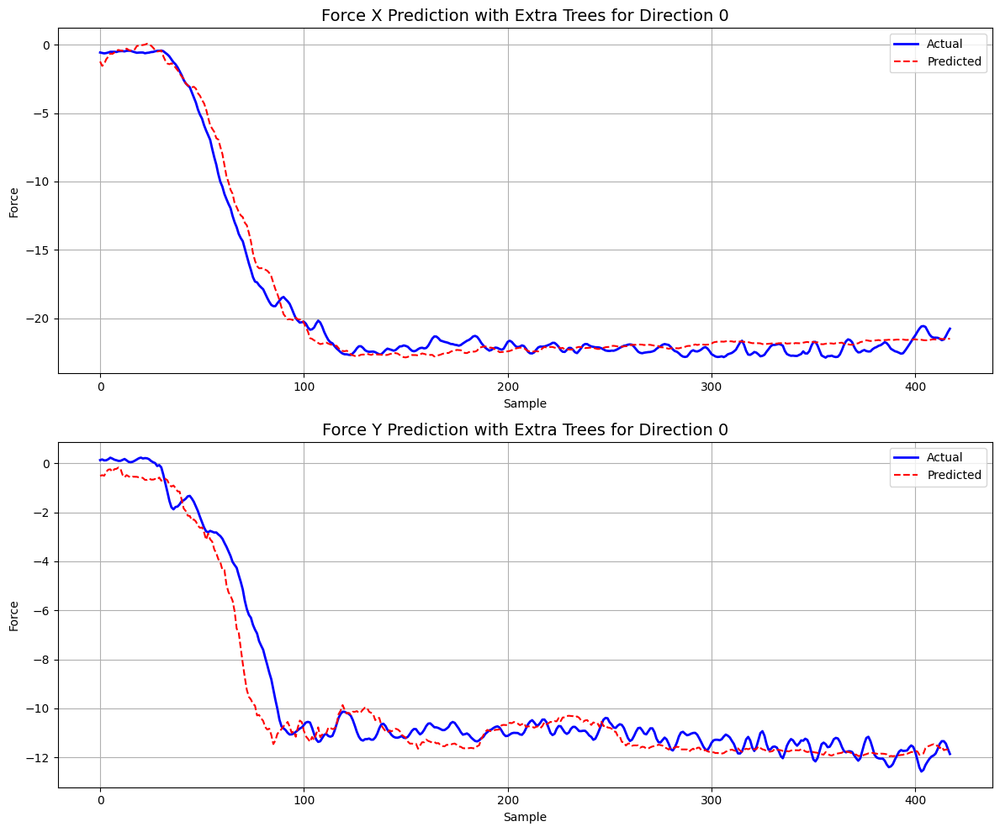

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 0 - Test RMSE: 0.7818, Test R²: 0.9717


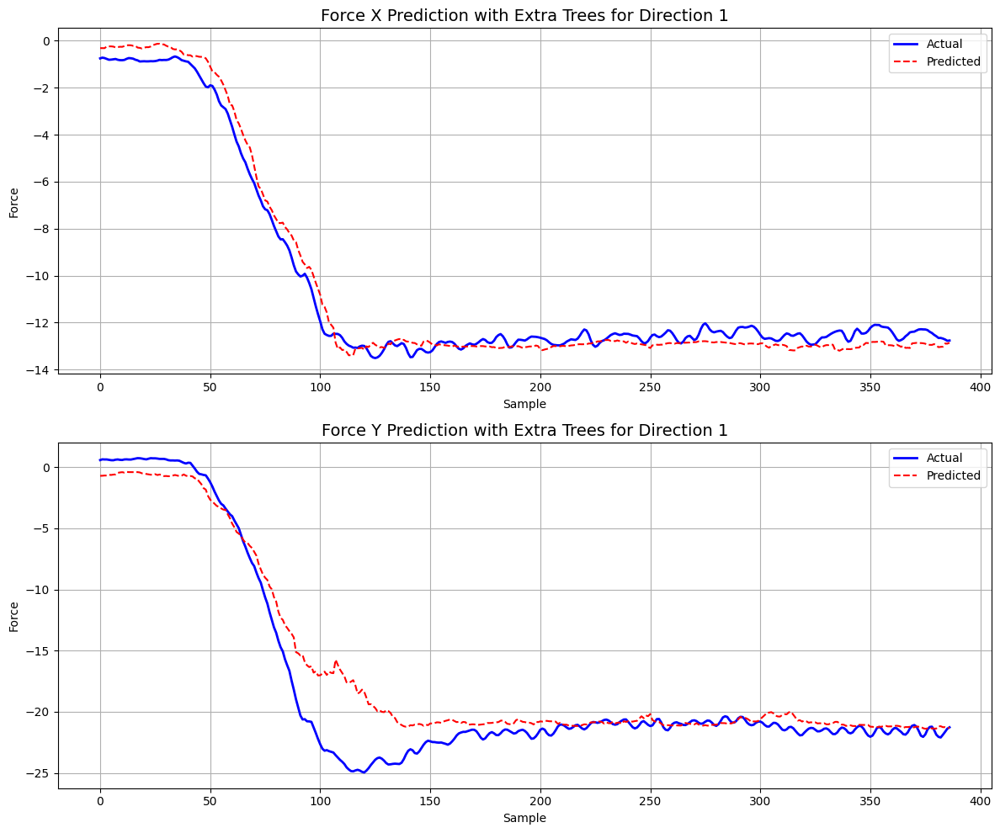

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 1 - Test RMSE: 1.6017, Test R²: 0.9566


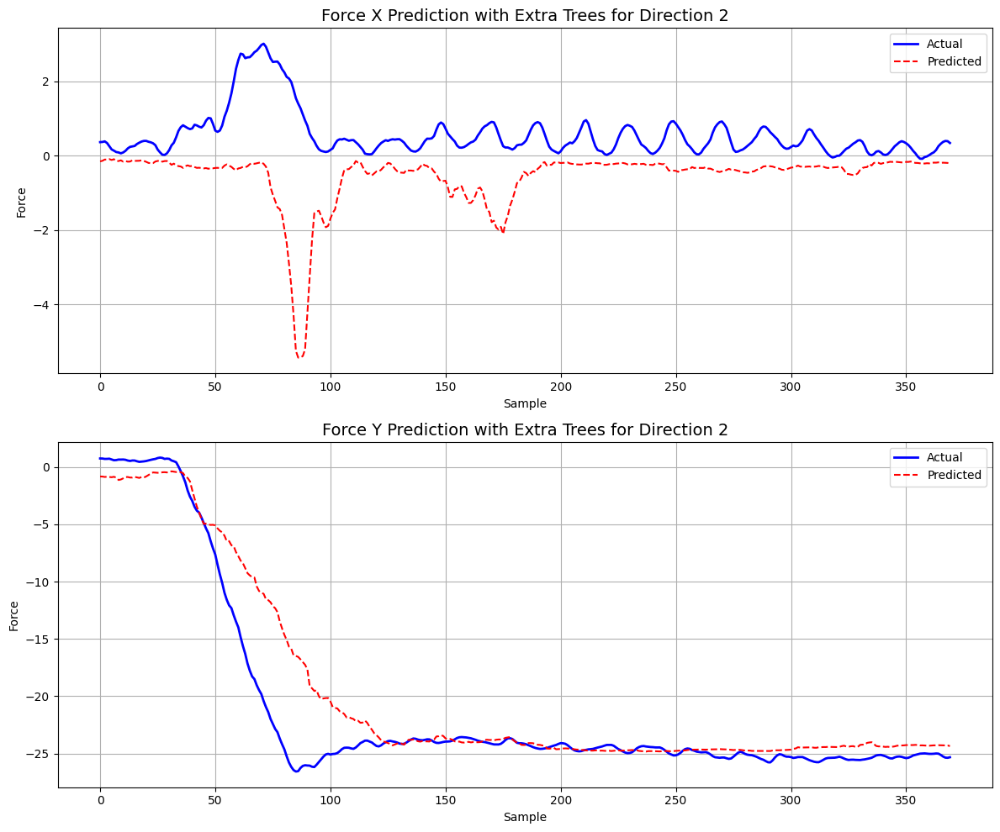

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 2 - Test RMSE: 2.4524, Test R²: -2.2169


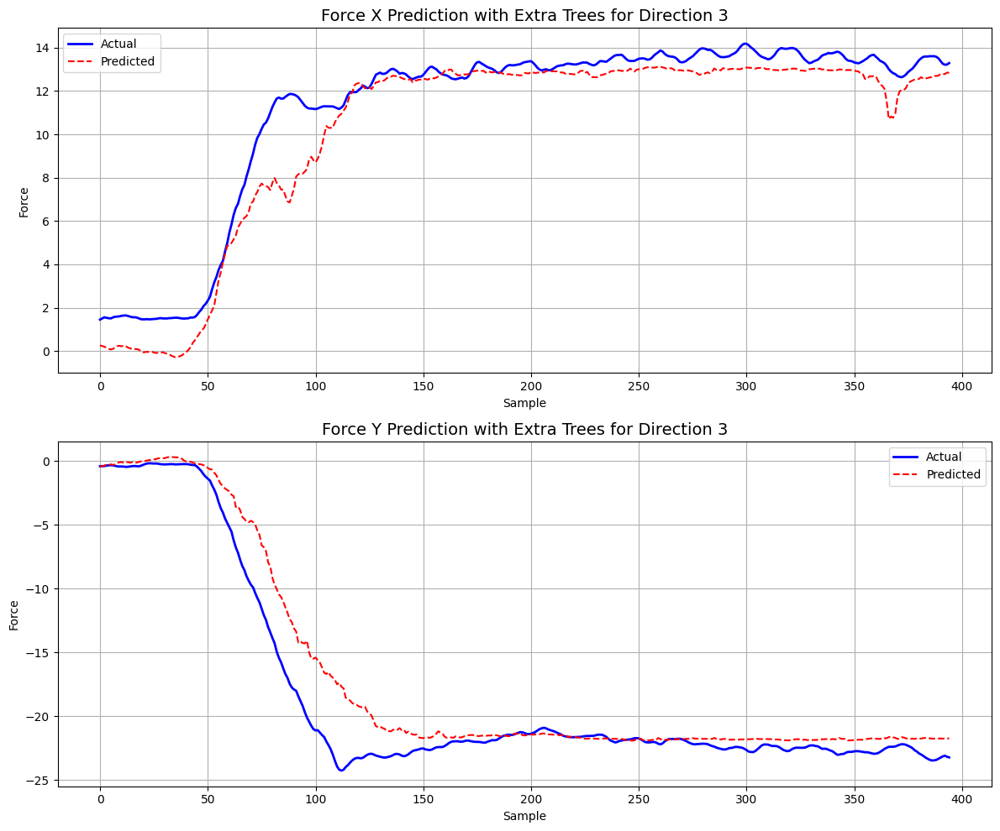

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 3 - Test RMSE: 1.7807, Test R²: 0.9158


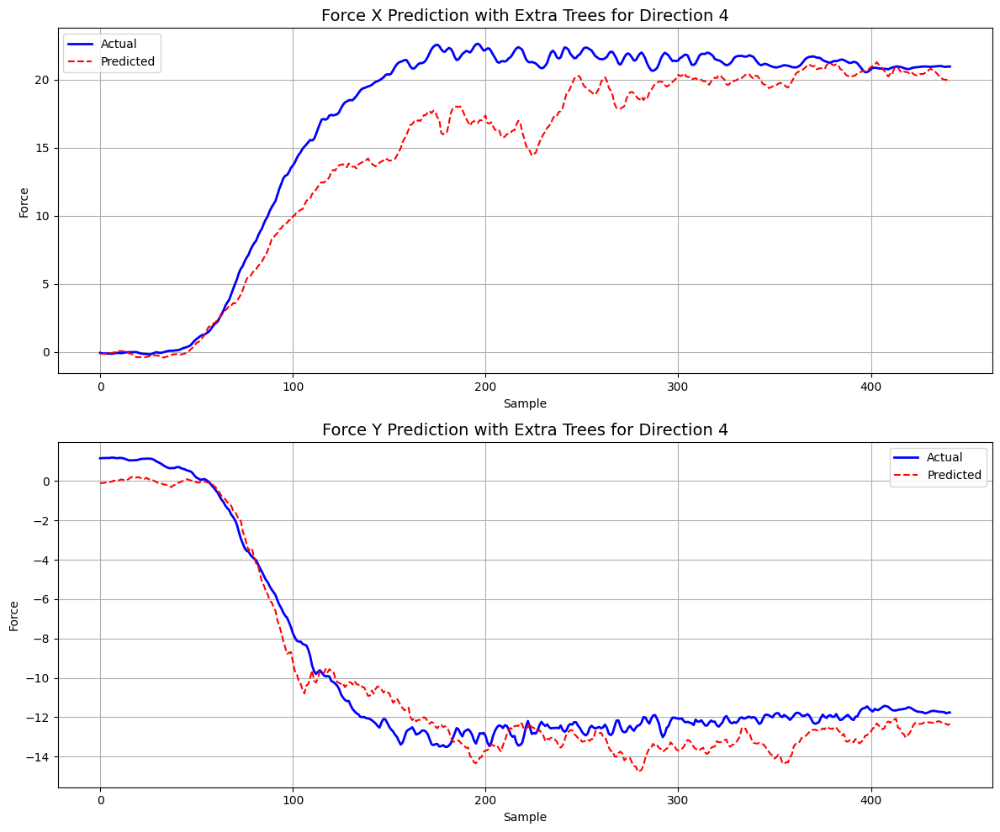

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 4 - Test RMSE: 2.3734, Test R²: 0.8914


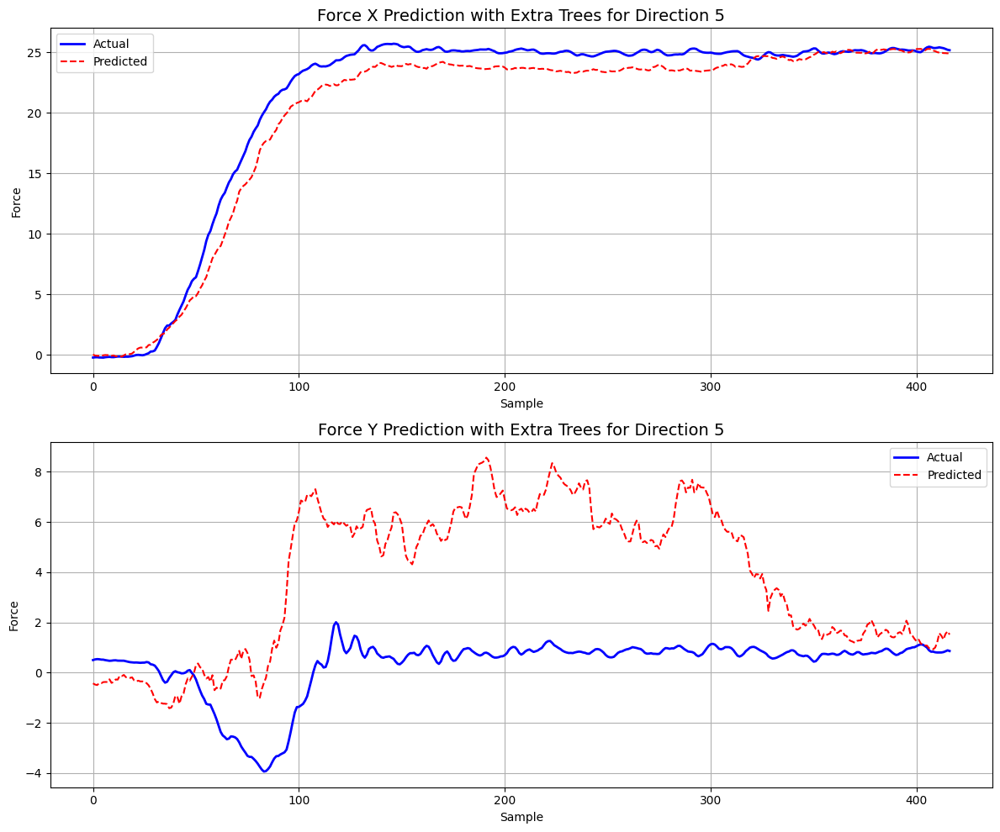

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 5 - Test RMSE: 3.2627, Test R²: -5.8592


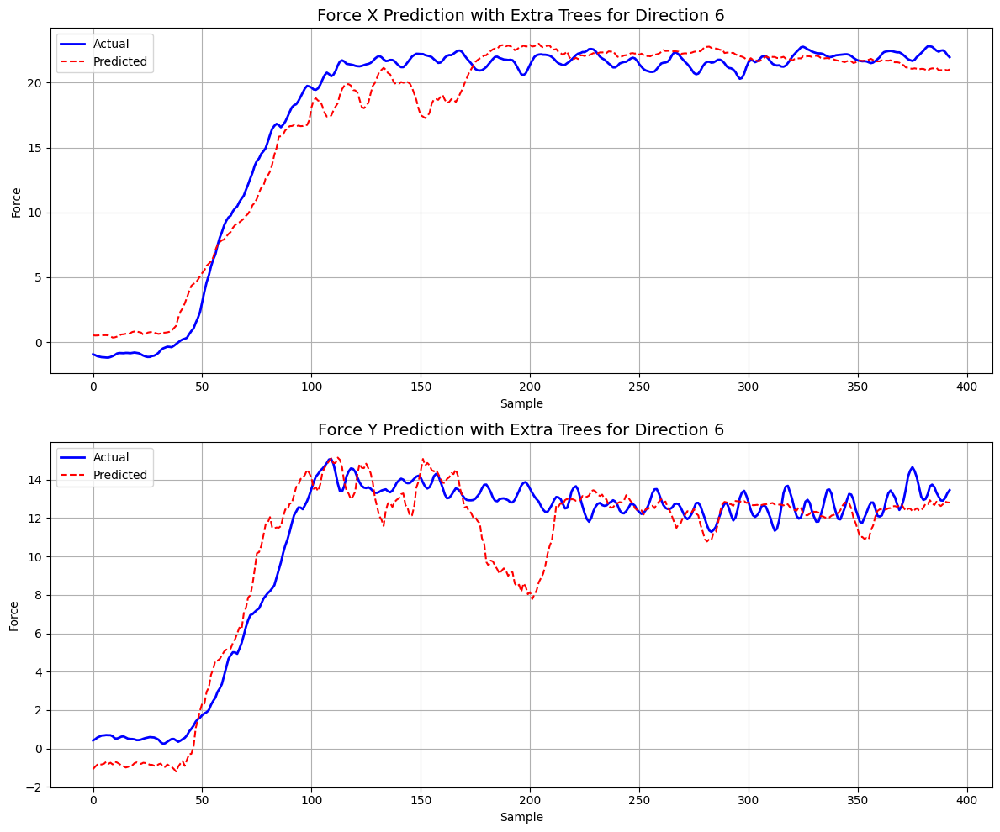

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 6 - Test RMSE: 1.6071, Test R²: 0.9168


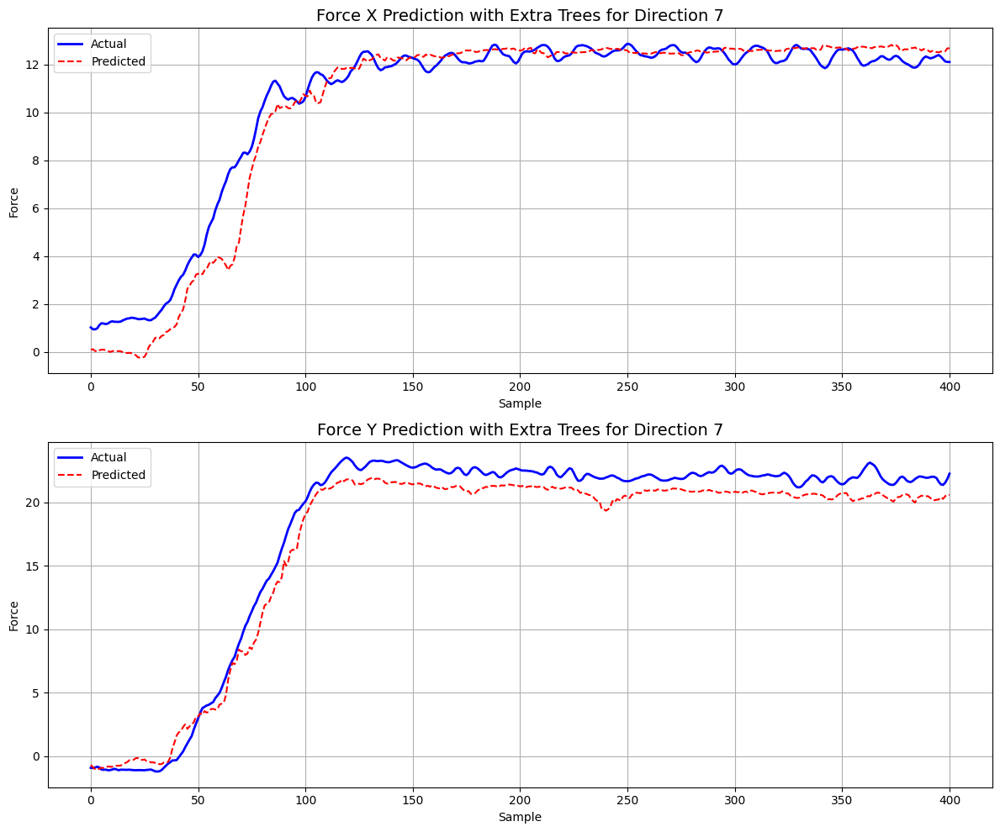

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 7 - Test RMSE: 1.1761, Test R²: 0.9553


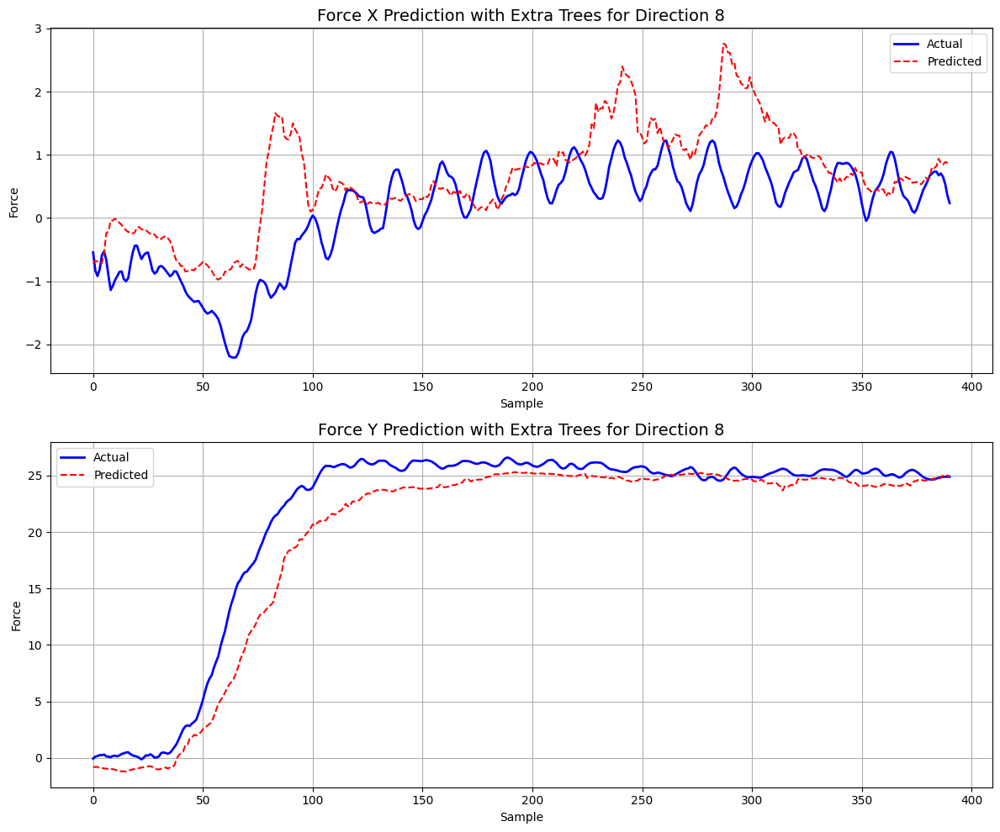

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 8 - Test RMSE: 1.8579, Test R²: 0.3978


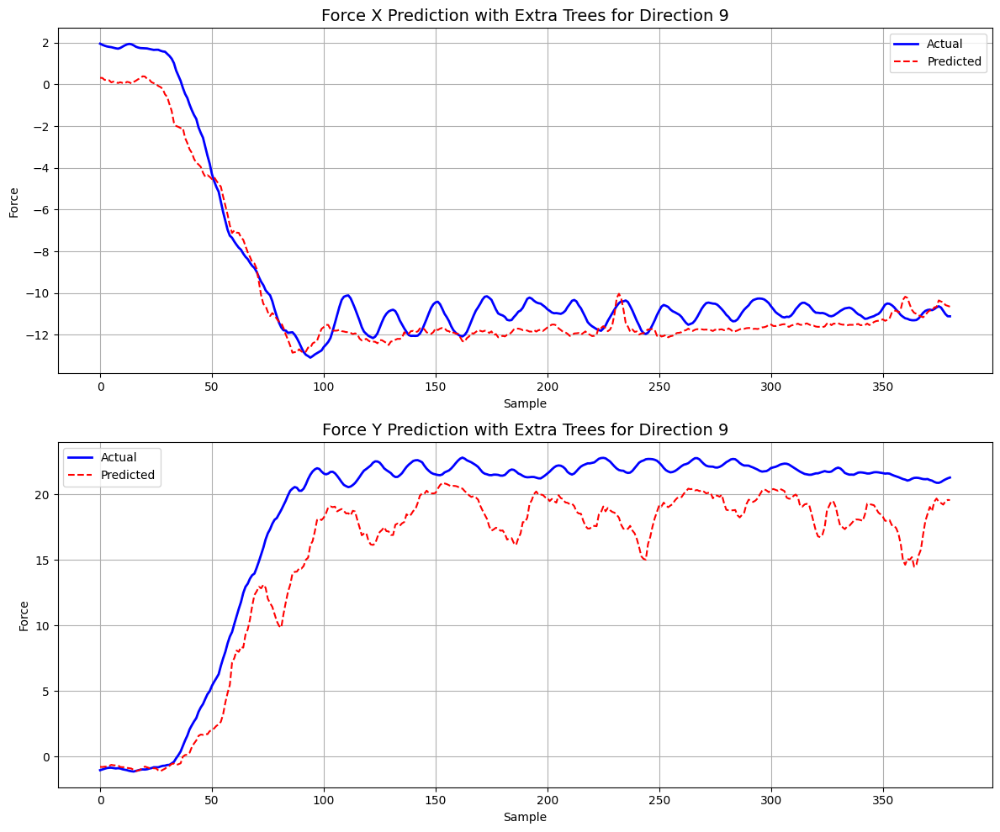

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 9 - Test RMSE: 2.6278, Test R²: 0.8582


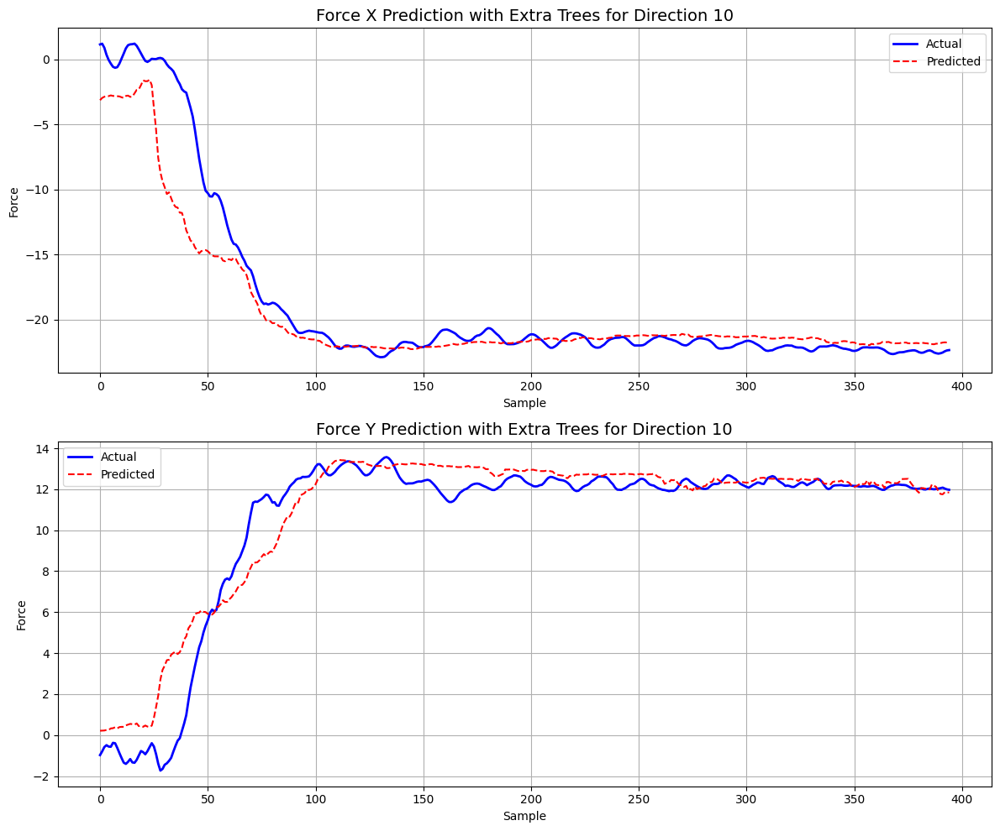

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 10 - Test RMSE: 1.9816, Test R²: 0.8921


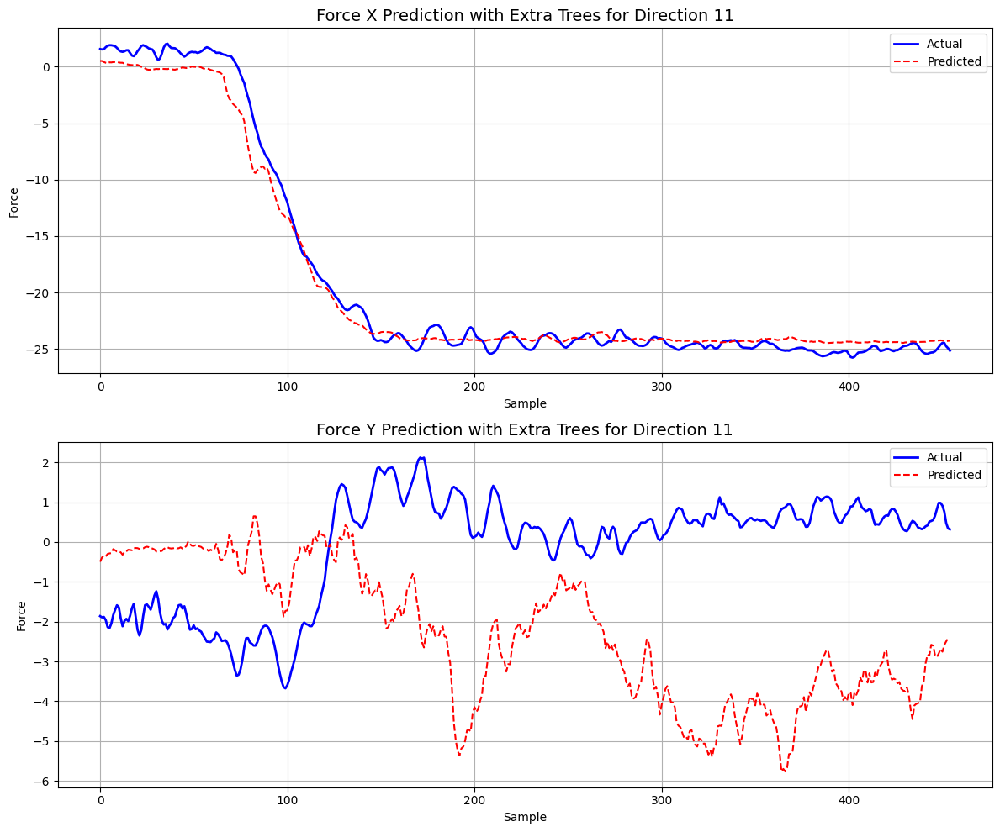

MultiOutputRegressor(estimator=ExtraTreesRegressor(min_samples_split=5,
                                                   n_estimators=200,
                                                   random_state=0)) - Direction 11 - Test RMSE: 2.6181, Test R²: -2.2957


In [17]:
# Get the maximum repetition value
last_rep = merged_df['repetition'].max()

# Select specific directions to plot
direction_to_plot = 12  # Can be changed to any value from 0 to 11

# Get the best model name
best_model_name = min(model_results, key=lambda x: model_results[x]['RMSE'])

for i in range(direction_to_plot):
    # Get test data
    test_data = merged_df[merged_df['repetition'] == last_rep]
    
    # Create mask for the selected direction
    direction_mask = test_data['direction'] == i
    
    # Get the indices from the test data that match our direction
    filtered_indices = test_data[direction_mask].index
    
    # Filter y_test and predictions using the indices
    y_test_filtered = y_test.loc[filtered_indices]
    
    # For predictions, we need to map these indices back to positions in the array
    # Create a mapping from the original indices to positional indices
    indices_map = {idx: pos for pos, idx in enumerate(y_test.index)}
    
    # Get the positional indices for our filtered data
    positional_indices = [indices_map[idx] for idx in filtered_indices]
    
    # Now filter the predictions using the positional indices
    predictions_filtered = predictions[positional_indices]

    # Plot the model_results
    fig, (ax1, ax2) = plt.subplots(2, 1, figsize=(12, 10))

    # Force X
    ax1.plot(y_test_filtered["force_x"].values, label="Actual", color="blue", linewidth=2)
    ax1.plot(predictions_filtered[:, 0], label="Predicted", color="red", linestyle="--", linewidth=1.5)
    ax1.set_title(f"Force X Prediction with {best_model_name} for Direction {i}", fontsize=14)
    ax1.set_xlabel("Sample")
    ax1.set_ylabel("Force")
    ax1.legend()
    ax1.grid(True)

    # Force Y
    ax2.plot(y_test_filtered["force_y"].values, label="Actual", color="blue", linewidth=2)
    ax2.plot(predictions_filtered[:, 1], label="Predicted", color="red", linestyle="--", linewidth=1.5)
    ax2.set_title(f"Force Y Prediction with {best_model_name} for Direction {i}", fontsize=14)
    ax2.set_xlabel("Sample")
    ax2.set_ylabel("Force")
    ax2.legend()
    ax2.grid(True)

    plt.tight_layout()
    plt.show()

    # Calculate metrics for this specific direction
    rmse_direction = root_mean_squared_error(y_test_filtered, predictions_filtered)
    r2_direction = r2_score(y_test_filtered, predictions_filtered)
    print(f"{best_model} - Direction {i} - Test RMSE: {rmse_direction:.4f}, Test R²: {r2_direction:.4f}")


#### Trends the model has learned well:

- Smooth transitions from rest to steady-state forces → In many directions (e.g., Dir 1, 7, 9, 11 for Force X; Dir 0, 1, 6, 10 for Force Y), the model accurately predicts both the gradual buildup and the steady maintenance of force.
- Overall shape and amplitude during steady states → Especially in Force X, the model matches amplitude and general patterns well once the system settles.

#### Trends the model has not captured well:

- Rapid or sharp transitions → Particularly in Force Y (Dirs 2, 3, 5, 11), the model lags or fails to follow sudden changes, suggesting difficulty with fast temporal dynamics.
Negative-to-positive or direction reversals → The model struggles when the force direction flips (e.g., Dir 2 Force X, Dir 11 Force Y), sometimes even predicting the wrong sign.
- Oscillation depth and amplitude during transients → In some cases, like Dir 2 and 4, the model underestimates peaks or valleys, missing the full range of the force oscillations.


### 4.3 Evaluation of XGBoost Force Prediction Model

RMSE for force_x: 2.0691, RMSE for force_y: 2.8623, Total RMSE: 2.4974
R² for force_x: 0.9832, R² for force_y: 0.9669, Total R²: 0.9750


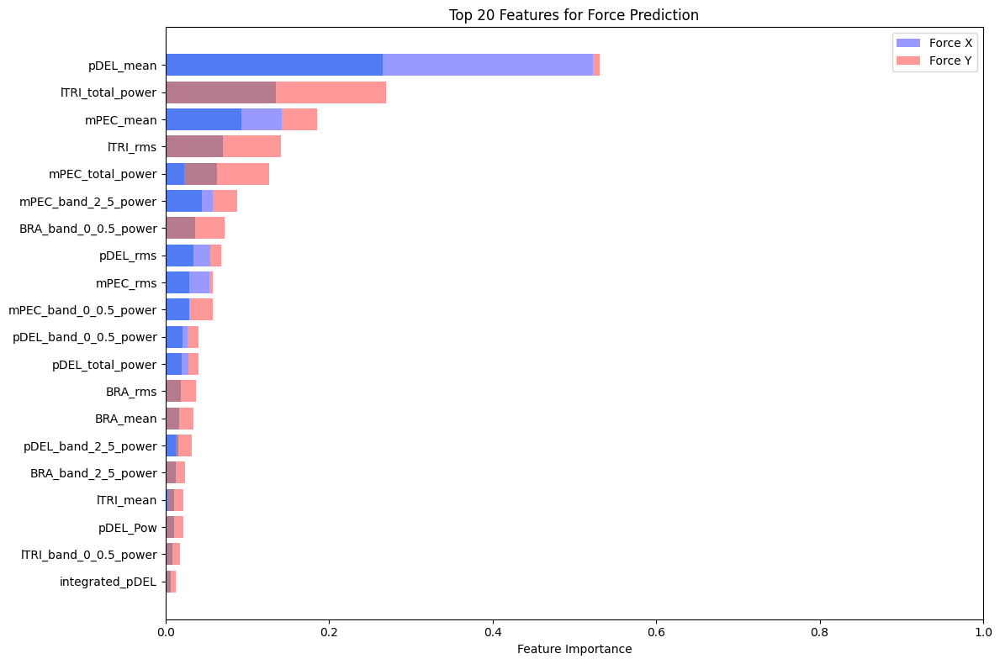

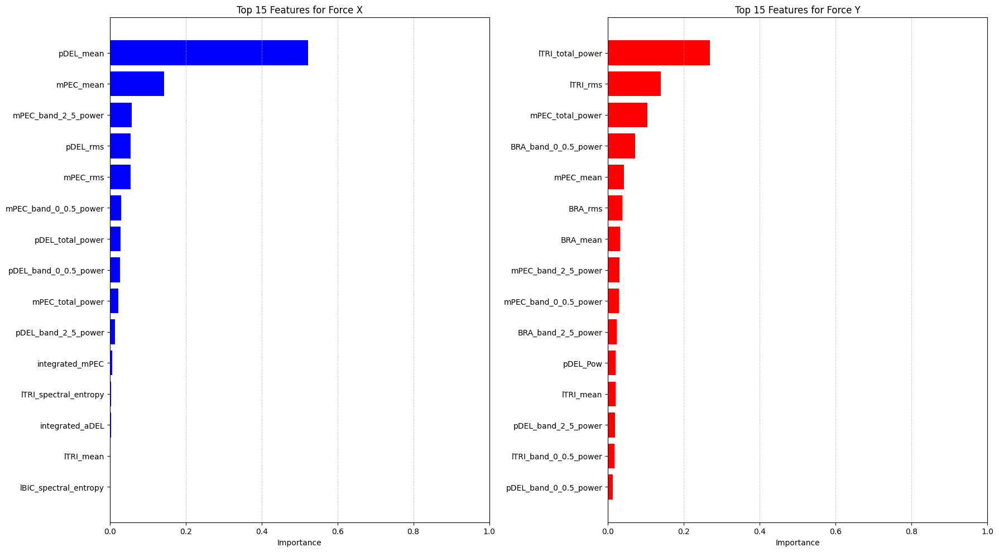

In [34]:
# Train models and make predictions
xgb_model_x, xgb_model_y = [xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, learning_rate=0.1, max_depth=5, subsample=0.8, colsample_bytree=0.8, random_state=42) for _ in range(2)]
xgb_model_x.fit(X_train, y_train['force_x'])
xgb_model_y.fit(X_train, y_train['force_y'])
x_pred, y_pred = xgb_model_x.predict(X_test), xgb_model_y.predict(X_test)

# Evaluate performance
rmse_x = np.sqrt(mean_squared_error(y_test['force_x'], x_pred))
rmse_y = np.sqrt(mean_squared_error(y_test['force_y'], y_pred))
rmse_total = np.sqrt(mean_squared_error(y_test, np.column_stack((x_pred, y_pred))))

r2_x = r2_score(y_test['force_x'], x_pred)
r2_y = r2_score(y_test['force_y'], y_pred)
r2_total = r2_score(y_test, np.column_stack((x_pred, y_pred)))

print(f"RMSE for force_x: {rmse_x:.4f}, RMSE for force_y: {rmse_y:.4f}, Total RMSE: {rmse_total:.4f}")
print(f"R² for force_x: {r2_x:.4f}, R² for force_y: {r2_y:.4f}, Total R²: {r2_total:.4f}")

# Feature importances and plot
feature_importance = pd.DataFrame({
    'Feature': X_train_df.columns.tolist(),
    'Importance_force_x': xgb_model_x.feature_importances_,
    'Importance_force_y': xgb_model_y.feature_importances_,
    'Average_Importance': (xgb_model_x.feature_importances_ + xgb_model_y.feature_importances_) / 2
}).sort_values('Average_Importance', ascending=False)

# Plot
top_features = feature_importance.head(20)
plt.figure(figsize=(12, 8))
plt.barh(top_features['Feature'], top_features['Average_Importance'], color='skyblue')
plt.barh(top_features['Feature'], top_features['Importance_force_x'], left=0, color='blue', alpha=0.4, label='Force X')
plt.barh(top_features['Feature'], top_features['Importance_force_y'], left=top_features['Importance_force_x'], color='red', alpha=0.4, label='Force Y')
plt.xlim(0, 1)
plt.xlabel('Feature Importance')
plt.title('Top 20 Features for Force Prediction')
plt.gca().invert_yaxis()
plt.legend()
plt.tight_layout()
plt.show()

# Plot separate top 15 for each force
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10))
for ax, importance, color, title in zip([ax1, ax2], ['Importance_force_x', 'Importance_force_y'], ['blue', 'red'], ['Force X', 'Force Y']):
    top_features = feature_importance.sort_values(importance, ascending=False).head(15)
    ax.barh(top_features['Feature'], top_features[importance], color=color)
    ax.set_title(f'Top 15 Features for {title}')
    ax.set_xlabel('Importance')
    ax.invert_yaxis()
    ax.set_xlim(0, 1)
    ax.grid(axis='x', linestyle='--', alpha=0.6)
plt.tight_layout()
plt.show()


### Key Points Evaluation of XGBoost Force Prediction Model

- Model implements **separate XGBoost regressors** for force_x and force_y components
- Uses moderate hyperparameters (100 estimators, 0.1 learning rate, max_depth=5)
- Performance metrics include both RMSE and R² scores for comprehensive evaluation
- **Feature importance analysis reveals distinct muscle contributions** to different force directions
- **Force X prediction** heavily depends on `pDEL_mean` (posterior deltoid activation)
- **Force Y prediction** primarily relies on `lTRI_total_power` (lateral triceps power)
- The visualization shows clear **biomechanical specialization** - shoulder muscles (pDEL) dominate horizontal forces while elbow muscles (lTRI) control vertical forces
- Secondary contributions come from chest muscle (`mPEC`) features for both force dimensions
- Time-domain features (mean, RMS) appear more important than frequency-domain features
- Total model feature importance combines both force dimensions for comprehensive ranking


### 4.4 Extra trees Feature Importance Analysis

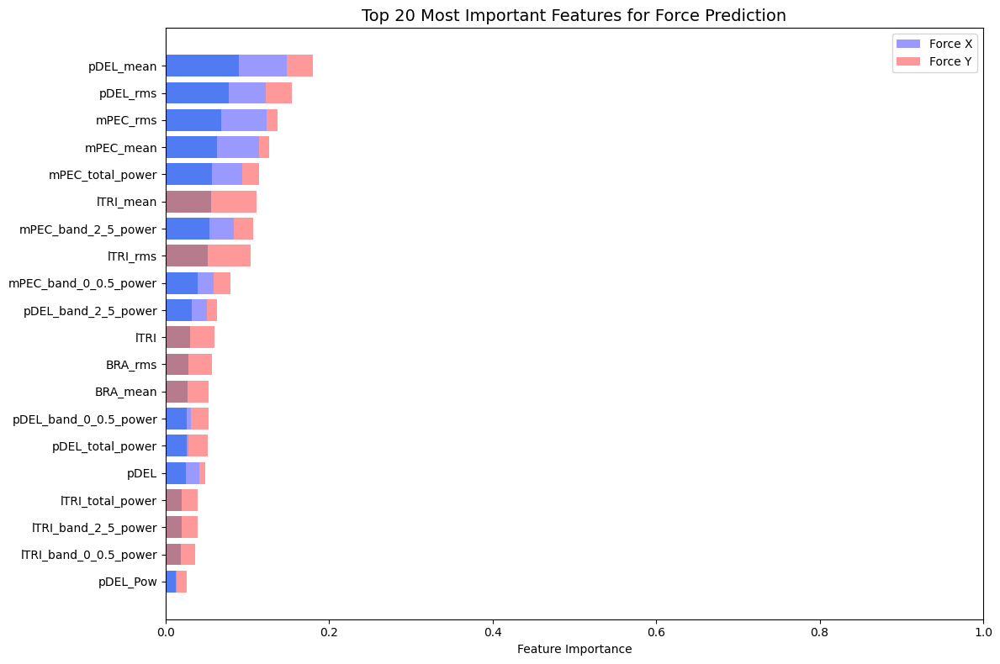

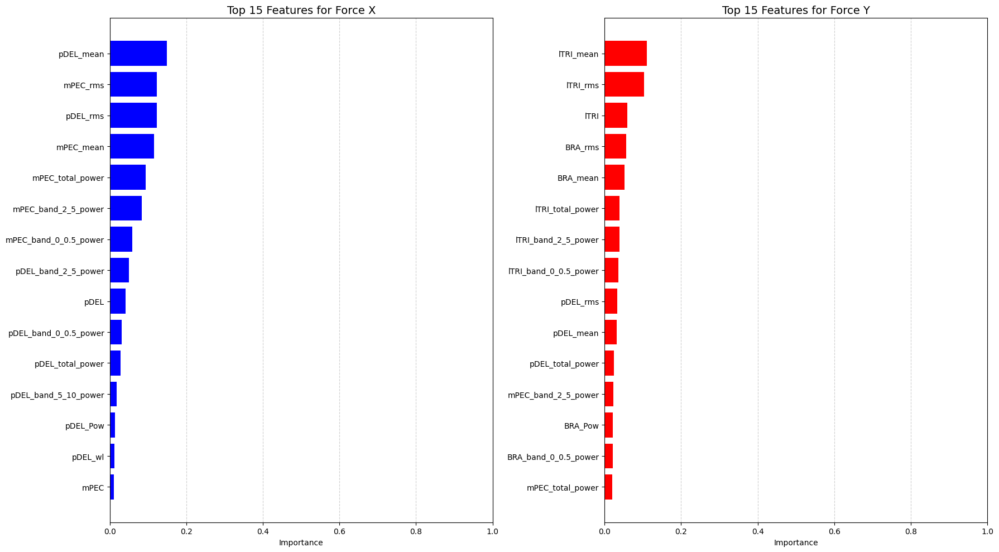

In [31]:
try:
    fx_importance, fy_importance = best_model.estimators_[0].feature_importances_, best_model.estimators_[1].feature_importances_
except (AttributeError, IndexError):
    fx_importance, fy_importance = xgb_model_x.feature_importances_, xgb_model_y.feature_importances_

feature_importance = pd.DataFrame({
    'Feature': X_train_df.columns.tolist(),
    'Importance_force_x': fx_importance,
    'Importance_force_y': fy_importance,
    'Average_Importance': (fx_importance + fy_importance) / 2
}).sort_values('Average_Importance', ascending=False)

# Plot top 20 features
plt.figure(figsize=(12, 8))
top_features = feature_importance.head(20)
plt.barh(top_features['Feature'], top_features['Average_Importance'], color='skyblue')
plt.barh(top_features['Feature'], top_features['Importance_force_x'], left=0, color='blue', alpha=0.4, label='Force X')
plt.barh(top_features['Feature'], top_features['Importance_force_y'], left=top_features['Importance_force_x'], color='red', alpha=0.4, label='Force Y')
plt.xlim(0, 1)
plt.xlabel('Feature Importance')
plt.title('Top 20 Most Important Features for Force Prediction', fontsize=14)
plt.gca().invert_yaxis()
plt.legend()
plt.tight_layout()
plt.show()

# Plot top 15 for force_x and force_y separately
fig, (ax1, ax2) = plt.subplots(1, 2, figsize=(18, 10))
top_x_features, top_y_features = feature_importance.sort_values('Importance_force_x', ascending=False).head(15), feature_importance.sort_values('Importance_force_y', ascending=False).head(15)

ax1.barh(top_x_features['Feature'], top_x_features['Importance_force_x'], color='blue')
ax1.set_title('Top 15 Features for Force X', fontsize=14)
ax1.set_xlabel('Importance')
ax1.invert_yaxis()
ax1.set_xlim(0, 1)
ax1.grid(axis='x', linestyle='--', alpha=0.6)

ax2.barh(top_y_features['Feature'], top_y_features['Importance_force_y'], color='red')
ax2.set_title('Top 15 Features for Force Y', fontsize=14)
ax2.set_xlabel('Importance')
ax2.invert_yaxis()
ax2.set_xlim(0, 1)
ax2.grid(axis='x', linestyle='--', alpha=0.6)

plt.tight_layout()
plt.show()


- **Force X prediction** is dominated by posterior deltoid (`pDEL`) and pectoral muscle (`mPEC`) features
  - `pDEL_mean` stands as the most important feature (importance ~0.15)
  - Time-domain features (`mean`, `rms`) are more influential than frequency features
  - Pectoral muscle (`mPEC`) features occupy 4 of the top 6 positions

- **Force Y prediction** relies heavily on triceps (`lTRI`) and brachialis (`BRA`) features
  - `lTRI_mean` and `lTRI_rms` are the top contributors
  - More even distribution of importance across multiple muscle groups
  - Elbow muscles show greater relevance than shoulder muscles

- **Overall importance values** are relatively low (under 0.2), indicating the model uses multiple features rather than depending on just a few dominant ones

### Comparison with Previous Models

- **Distribution shift**: Current model shows more balanced feature importance compared to previous models where certain features (e.g., `pDEL_mean`) had much higher importance (~0.6)

- **Muscle focus change**: Earlier model relied heavily on `lTRI_total_power` for Force Y, while current model prioritizes `lTRI_mean`

- **Feature type preference**: Both models favor time-domain features (mean, RMS) over frequency domain measures, but current model shows more even distribution across these measures

- **Physiological alignment**: Both models demonstrate biomechanically logical patterns - shoulder muscles for horizontal forces and elbow muscles for vertical forces

This more balanced feature importance suggests the current model may be more robust against individual feature variations and potentially generalizes better across different movement patterns.


### 4.5 SHAP Analysis

Generating SHAP values for Extra Trees...
Using TreeExplainer for tree-based models...
Generating SHAP summary plot for force_x...


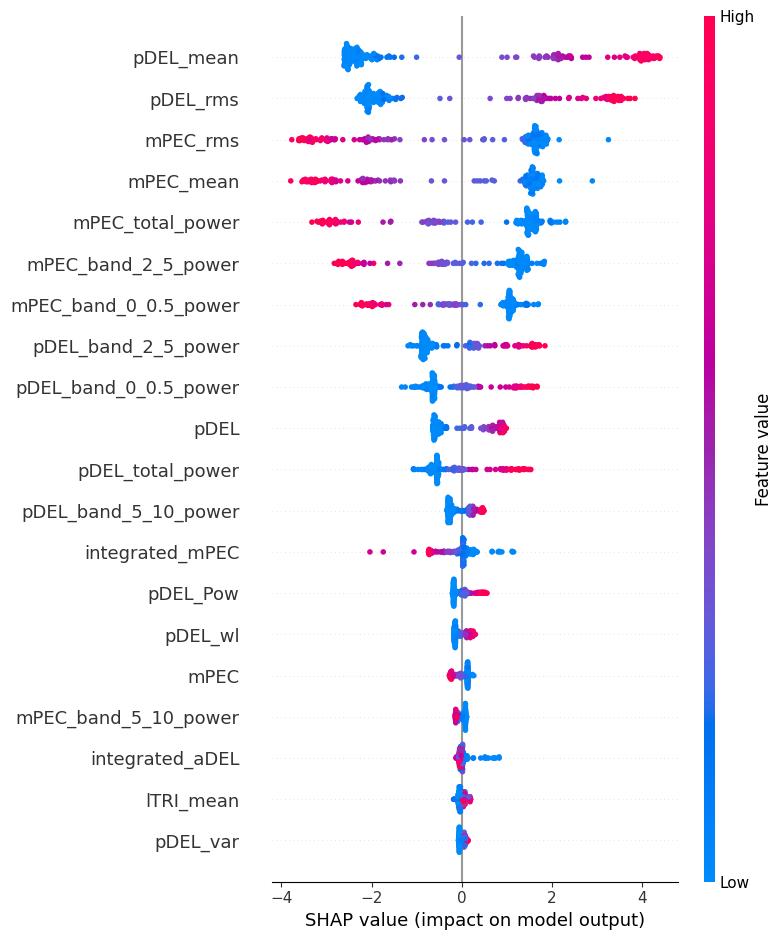

Generating SHAP summary plot for force_y...


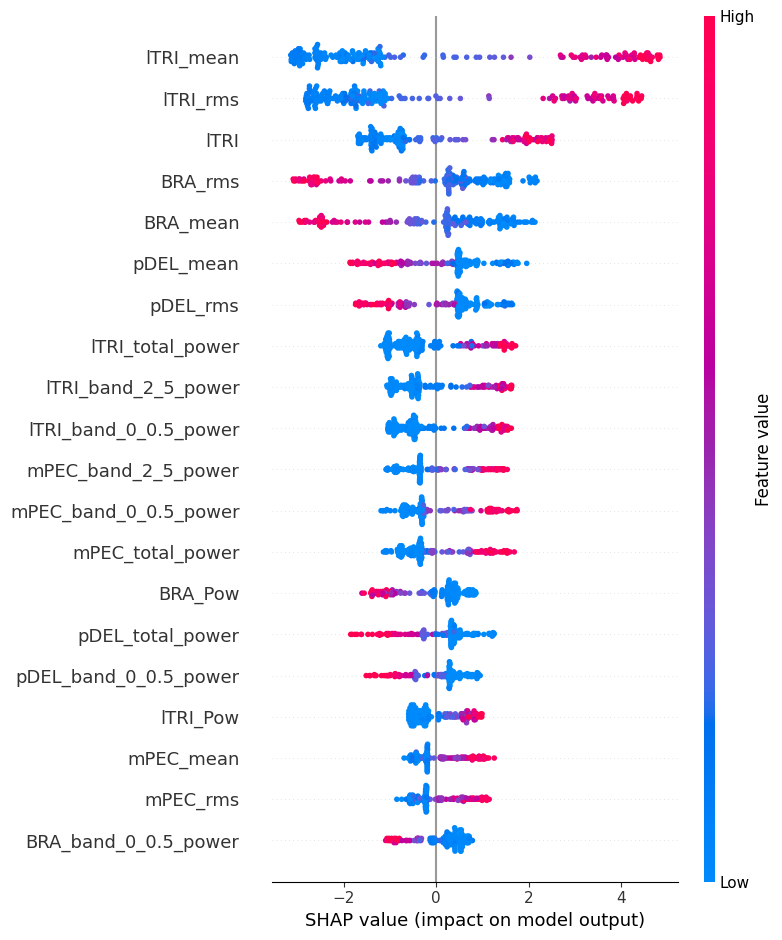

In [22]:
import shap

print(f"Generating SHAP values for {best_model_name}...")

# Randomly sample 200 rows from the DataFrame
X_sample = X_test_df.sample(n=200, random_state=0).to_numpy()  # Set random_state for reproducibility
feature_names = X_test_df.columns.tolist()

if best_model_name in ["Random Forest", "Extra Trees", "Gradient Boosting", "HistGradientBoosting"]:
    print("Using TreeExplainer for tree-based models...")
    # Extract individual regressors
    force_x_model = best_model.estimators_[0]
    force_y_model = best_model.estimators_[1]

    # Create separate TreeExplainers
    explainer_x = shap.TreeExplainer(force_x_model)
    explainer_y = shap.TreeExplainer(force_y_model)

    # Calcola gli SHAP values separatamente
    shap_values_x = explainer_x.shap_values(X_sample)
    shap_values_y = explainer_y.shap_values(X_sample)

    print("Generating SHAP summary plot for force_x...")
    shap.summary_plot(shap_values_x, X_sample, feature_names=feature_names)

    print("Generating SHAP summary plot for force_y...")
    shap.summary_plot(shap_values_y, X_sample, feature_names=feature_names)

else:
    print("Using KernelExplainer for non-tree-based models...")
    # KernelExplainer fallback
    explainer = shap.KernelExplainer(best_model.predict, X_train[:100])
    shap_values = explainer.shap_values(X_sample[:100])
    X_sample = X_sample[:100]

    print("Generating SHAP summary plot for force_x...")
    shap.summary_plot(shap_values[0], X_sample, feature_names=feature_names)

    print("Generating SHAP summary plot for force_y...")
    shap.summary_plot(shap_values[1], X_sample, feature_names=feature_names)



#### SHAP Analysis Interpretation

The SHAP (SHapley Additive exPlanations) plots largely confirm the feature importance findings while providing deeper insights into how these features affect predictions:

- **Consistent feature ranking**: The SHAP analysis confirms the relative importance of features, with `pDEL_mean` and `pDEL_rms` dominating Force X predictions, while `lTRI_mean` and `lTRI_rms` primarily influence Force Y predictions.

- **Direction of impact revealed**: Unlike basic feature importance, SHAP shows *how* features impact predictions:
  - For Force X: Higher `pDEL_mean` values consistently push predictions higher (positive SHAP values up to +4)
  - For Force Y: Higher `lTRI_mean` values strongly correlate with positive predictions

- **Non-linear relationships**: SHAP reveals complex patterns that simple importance scores miss - for example, `mPEC_rms` has negative impact when values are high but positive impact when values are low

- **Magnitude of influence**: SHAP values for key features span from -4 to +4, showing they can substantially shift predictions in either direction

> Note: This SHAP analysis was performed on a random subset of 200 test samples due to computational demands, which is standard practice for SHAP calculations with complex models.


Generating SHAP Dependence Plot for force_x using feature pDEL_mean...


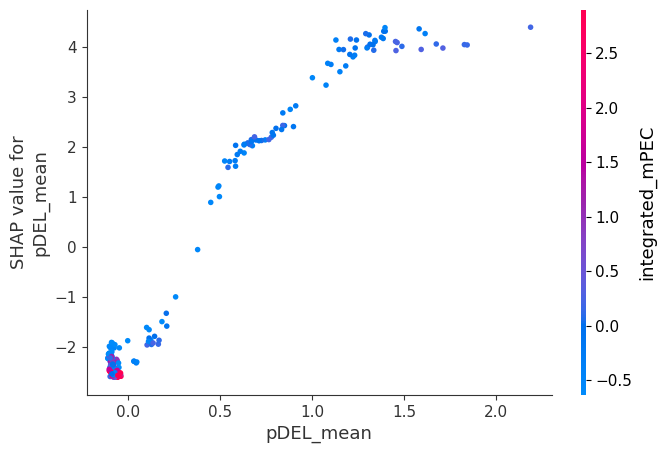

Generating SHAP Dependence Plot for force_y using feature lTRI_total_power...


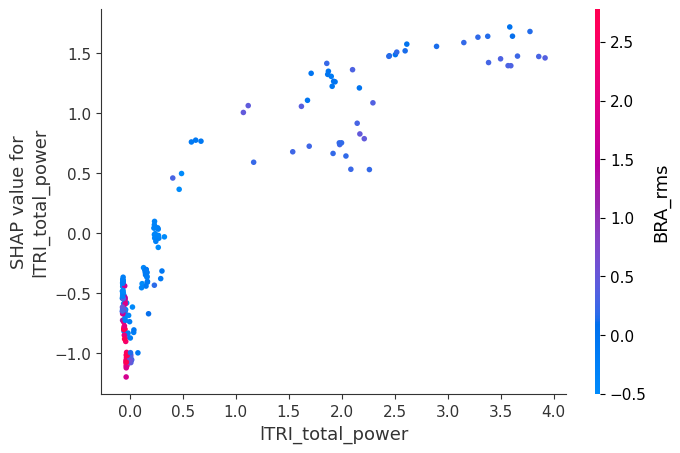

In [40]:
# 2. SHAP Dependence Plot (Choose a feature to analyze its effect on the prediction)
# Use feature index from the top important features
# Get one of the top features from our previous analysis
feature_idx = np.argmax(fx_importance)  # Index of most important feature for force_x
print(f"Generating SHAP Dependence Plot for force_x using feature {feature_names[feature_idx]}...")
shap.dependence_plot(feature_idx, shap_values_x, X_sample, feature_names=feature_names)

# For force_y, use a different important feature
feature_idx_y = np.argmax(fy_importance)  # Index of most important feature for force_y
print(f"Generating SHAP Dependence Plot for force_y using feature {feature_names[feature_idx_y]}...")
shap.dependence_plot(feature_idx_y, shap_values_y, X_sample, feature_names=feature_names)


In [46]:
# 3. SHAP Force Plot (Visualize for the 100th instance in the test set)
shap.initjs()  # Initialize JS for rendering

# For force plot, we need to handle expected value differently based on model type
expected_value_x = explainer_x.expected_value
expected_value_y = explainer_y.expected_value

# Select the 100th sample for visualization
sample_idx = 100
sample_data = X_sample[sample_idx]

print("Generating SHAP Force Plot for the 100th instance (force_x)...")
shap.force_plot(expected_value_x, shap_values_x[sample_idx], sample_data, feature_names=feature_names)

Generating SHAP Force Plot for the 100th instance (force_x)...


In [47]:

print("Generating SHAP Force Plot for the 100th instance (force_y)...")
shap.force_plot(expected_value_y, shap_values_y[sample_idx], sample_data, feature_names=feature_names)

Generating SHAP Force Plot for the 100th instance (force_y)...


### 4.6 Model error visualisation

Comprehensive plot about three models error statistics

C:\Users\somma\AppData\Local\Temp\ipykernel_3508\2181126775.py:15: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[0].boxplot([error_df[col] for col in x_columns], labels=[col.replace('_x', '') for col in x_columns])
C:\Users\somma\AppData\Local\Temp\ipykernel_3508\2181126775.py:22: MatplotlibDeprecationWarning: The 'labels' parameter of boxplot() has been renamed 'tick_labels' since Matplotlib 3.9; support for the old name will be dropped in 3.11.
  axes[1].boxplot([error_df[col] for col in y_columns], labels=[col.replace('_y', '') for col in y_columns])


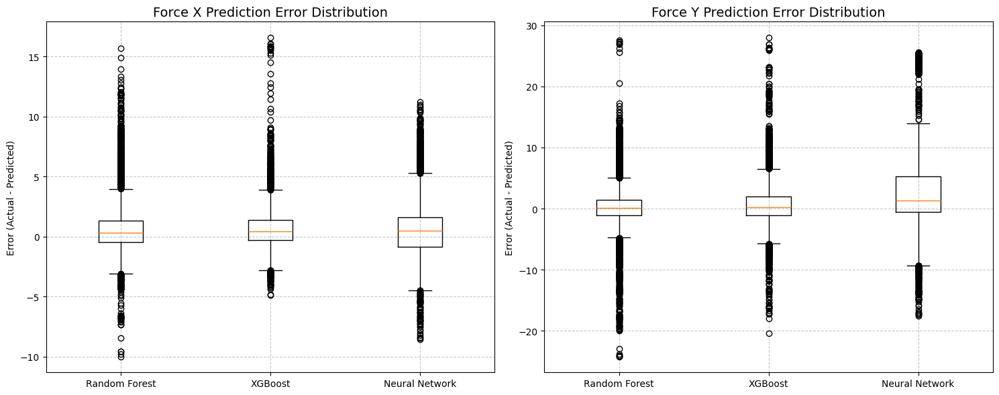

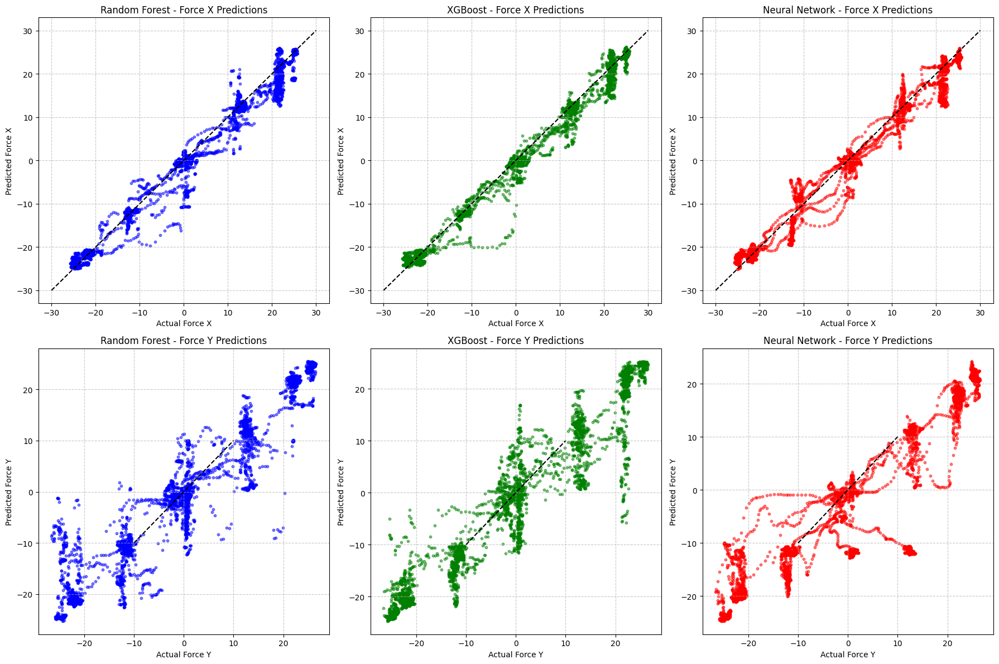

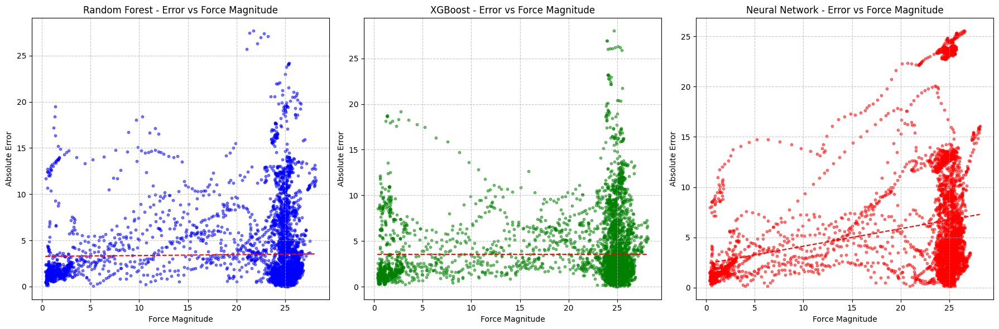

In [ ]:
# Compare all models on test set with boxplots
fig, axes = plt.subplots(1, 2, figsize=(15, 6))

# Gather prediction errors for all models
error_data = {}
for name, res in model_results.items():
    error_data[f"{name}_x"] = y_test["force_x"].values - model_results["predictions"][:, 0]
    error_data[f"{name}_y"] = y_test["force_y"].values - model_results["predictions"][:, 1]

# Create a DataFrame for easier plotting
error_df = pd.DataFrame(error_data)

# Plot force_x errors
x_columns = [col for col in error_df.columns if col.endswith('_x')]
axes[0].boxplot([error_df[col] for col in x_columns], labels=[col.replace('_x', '') for col in x_columns])
axes[0].set_title('Force X Prediction Error Distribution', fontsize=14)
axes[0].set_ylabel('Error (Actual - Predicted)')
axes[0].grid(True, linestyle='--', alpha=0.7)

# Plot force_y errors
y_columns = [col for col in error_df.columns if col.endswith('_y')]
axes[1].boxplot([error_df[col] for col in y_columns], labels=[col.replace('_y', '') for col in y_columns])
axes[1].set_title('Force Y Prediction Error Distribution', fontsize=14)
axes[1].set_ylabel('Error (Actual - Predicted)')
axes[1].grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# 2. Create scatter plots of actual vs predicted values
fig, axes = plt.subplots(2, 3, figsize=(18, 12))
axes = axes.flatten()

# Plot scatter plots for each model and force component
model_names = list(model_results.keys())
colors = ['blue', 'green', 'red']

for i, (name, color) in enumerate(zip(model_names, colors)):
    # Force X
    axes[i].scatter(y_test["force_x"], model_results[name]["predictions"][:, 0], 
                   alpha=0.5, color=color, s=10)
    axes[i].plot([-30, 30], [-30, 30], 'k--')  # Perfect prediction line
    axes[i].set_title(f'{name} - Force X Predictions', fontsize=12)
    axes[i].set_xlabel('Actual Force X')
    axes[i].set_ylabel('Predicted Force X')
    axes[i].grid(True, linestyle='--', alpha=0.7)
    
    # Force Y
    axes[i+3].scatter(y_test["force_y"], model_results[name]["predictions"][:, 1], 
                    alpha=0.5, color=color, s=10)
    axes[i+3].plot([-10, 10], [-10, 10], 'k--')  # Perfect prediction line
    axes[i+3].set_title(f'{name} - Force Y Predictions', fontsize=12)
    axes[i+3].set_xlabel('Actual Force Y')
    axes[i+3].set_ylabel('Predicted Force Y')
    axes[i+3].grid(True, linestyle='--', alpha=0.7)

plt.tight_layout()
plt.show()

# 3. Plot error distribution by force magnitude
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Get force magnitude from test data
force_magnitude = merged_df[merged_df['repetition'] == last_rep]['force_magnitude'].values

# Calculate absolute errors for each model
for i, (name, color) in enumerate(zip(model_names, colors)):
    force_x_error = np.abs(y_test["force_x"].values - model_results[name]["predictions"][:, 0])
    force_y_error = np.abs(y_test["force_y"].values - model_results[name]["predictions"][:, 1])
    total_error = np.sqrt(force_x_error**2 + force_y_error**2)
    
    axes[i].scatter(force_magnitude, total_error, alpha=0.5, color=color, s=10)
    axes[i].set_title(f'{name} - Error vs Force Magnitude', fontsize=12)
    axes[i].set_xlabel('Force Magnitude')
    axes[i].set_ylabel('Absolute Error')
    axes[i].grid(True, linestyle='--', alpha=0.7)
    
    # Add a trend line
    z = np.polyfit(force_magnitude, total_error, 1)
    p = np.poly1d(z)
    axes[i].plot(sorted(force_magnitude), p(sorted(force_magnitude)), 'r--', linewidth=1.5)

plt.tight_layout()
plt.show()

All models predict Force X well, with points tightly following the diagonal. Force Y predictions show more scatter across all models, with visible prediction patterns. XGBoost appears slightly more accurate for Force X, while Neural Network creates unusual prediction "streams." The boxplots confirm smaller errors for Force X predictions versus Force Y, suggesting horizontal forces are fundamentally easier to predict from muscle activations than vertical forces.

### 4.7 Plot the Error Over Time for Each Direction and three selected models

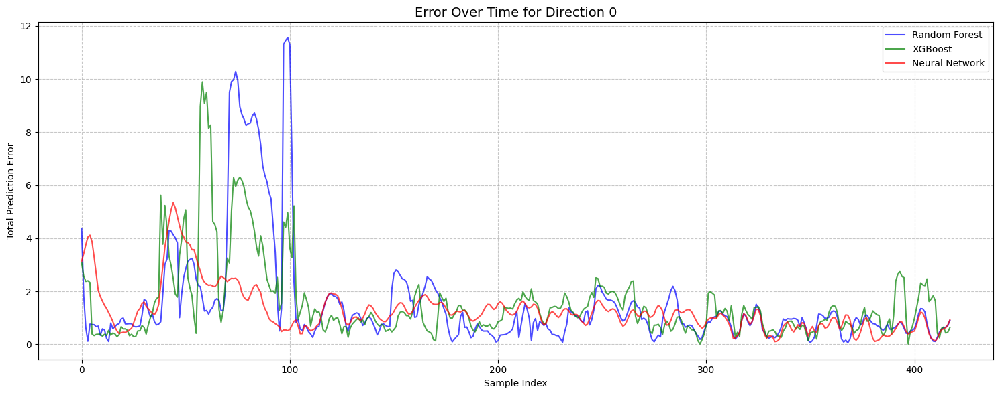

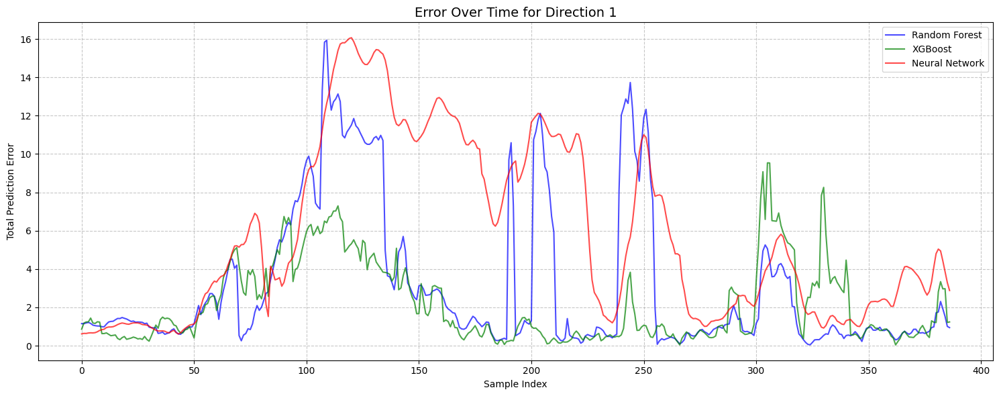

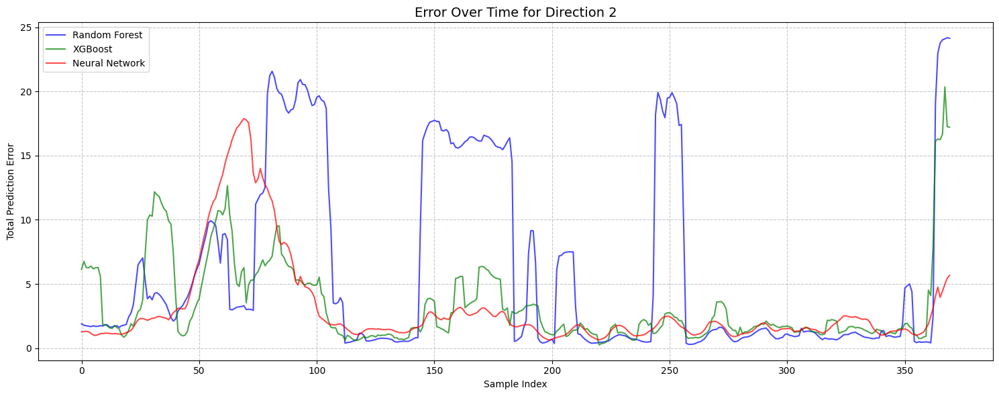

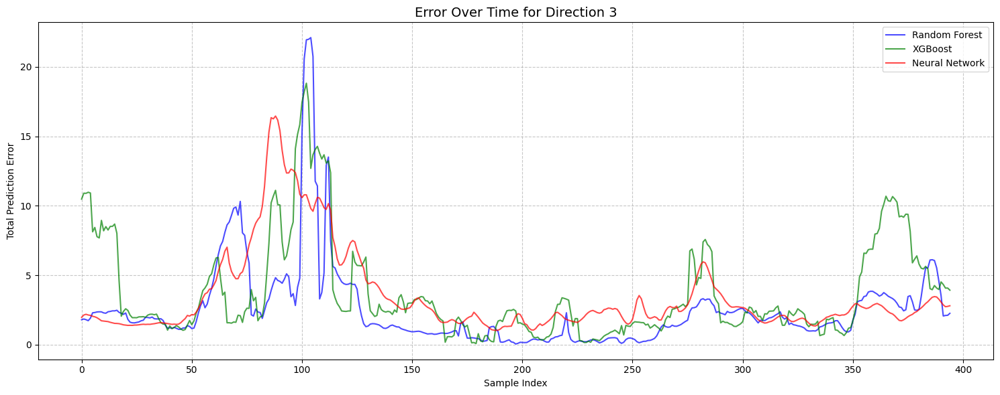

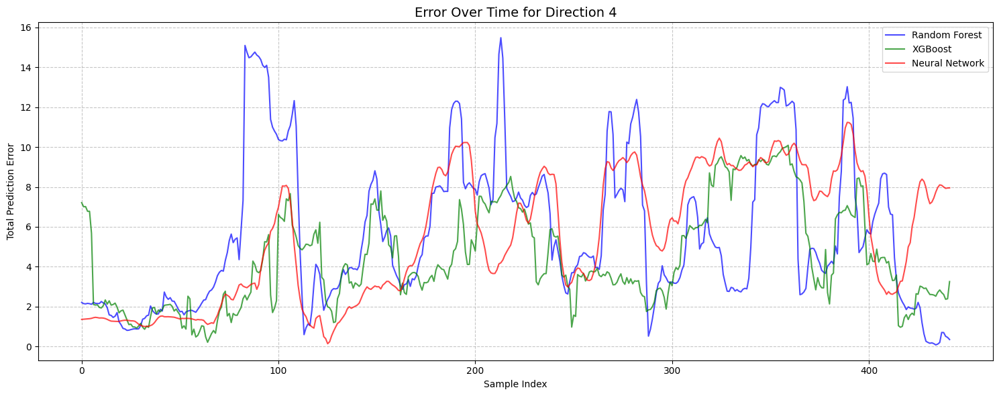

...

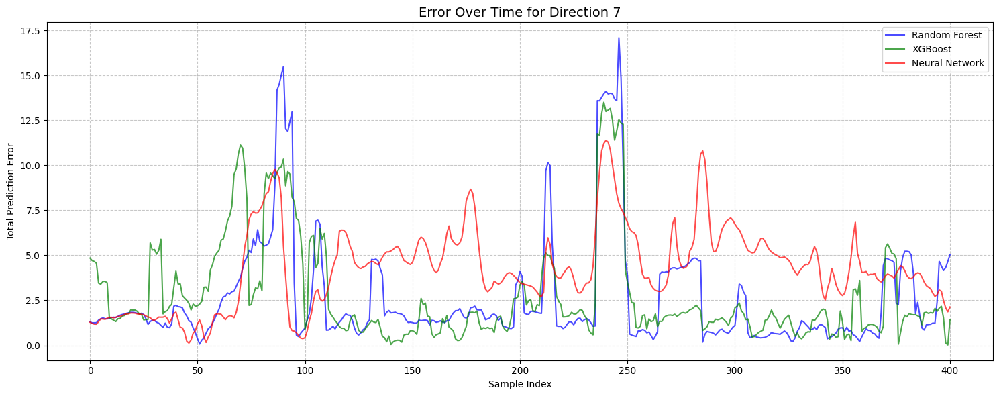

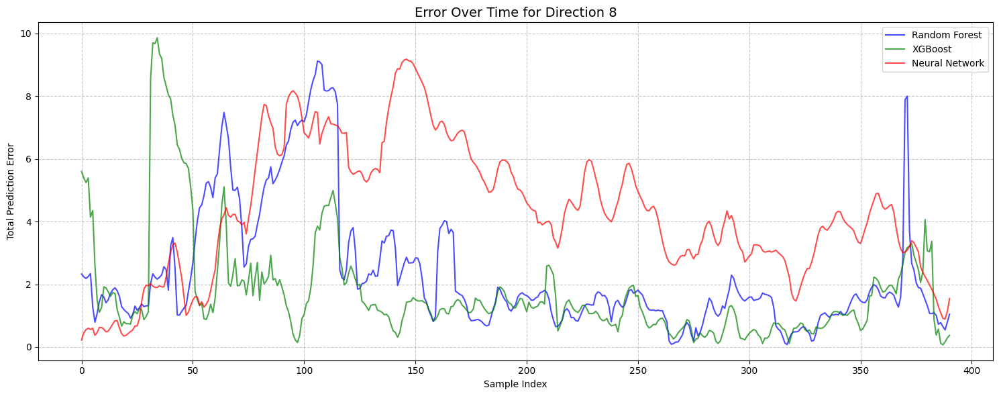

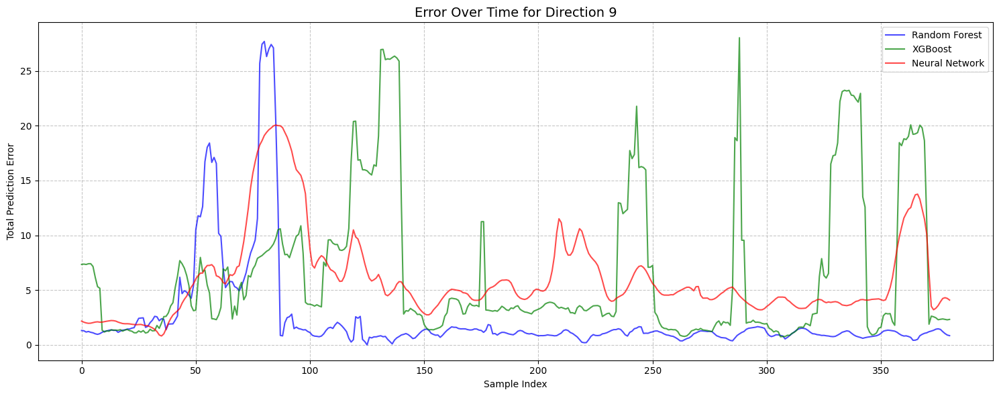

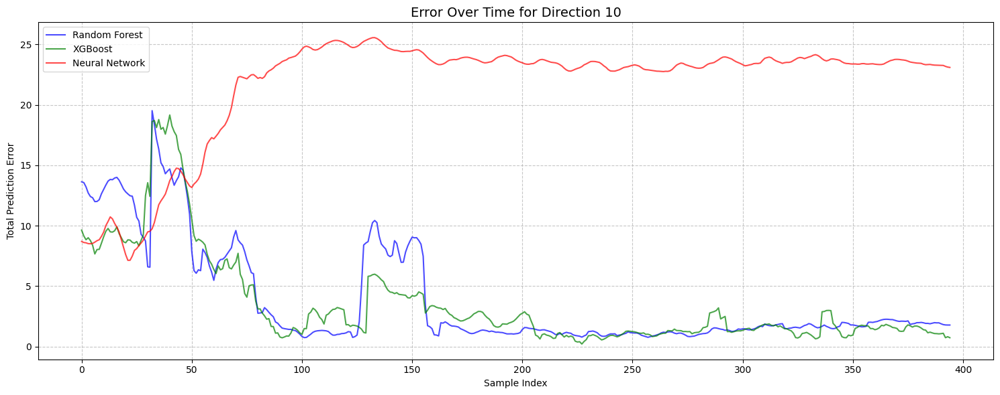

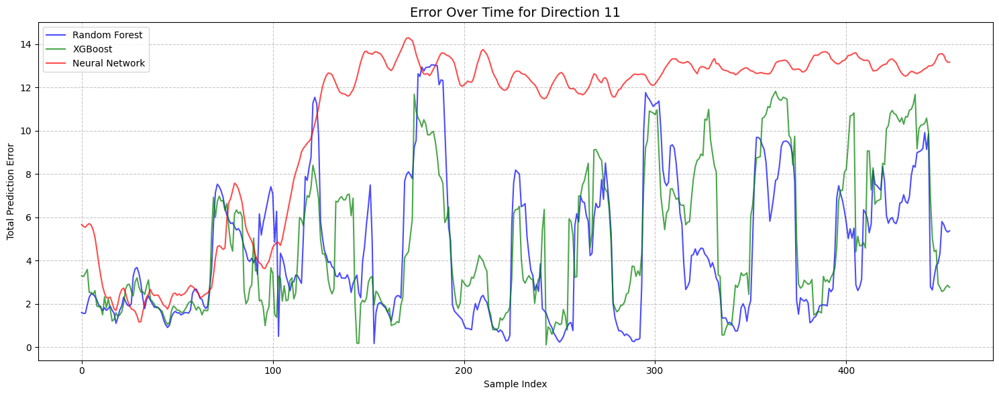

In [ ]:
# Plot error over time for a specific direction
direction_to_show = 12  # Can be changed
for i in range(direction_to_show):
    test_data = merged_df[merged_df['repetition'] == last_rep]
    direction_mask = test_data['direction'].values == i
    time_indices = np.arange(len(y_test.iloc[direction_mask]))

    fig, ax = plt.subplots(figsize=(15, 6))

    for name, color in zip(model_names, colors):
        force_x_error = np.abs(y_test.iloc[direction_mask]["force_x"].values - 
                            model_results[name]["predictions"][direction_mask][:, 0])
        force_y_error = np.abs(y_test.iloc[direction_mask]["force_y"].values - 
                            model_results[name]["predictions"][direction_mask][:, 1])
        total_error = np.sqrt(force_x_error**2 + force_y_error**2)
        
        ax.plot(time_indices, total_error, label=name, color=color, linewidth=1.5, alpha=0.7)

    ax.set_title(f'Error Over Time for Direction {i}', fontsize=14)
    ax.set_xlabel('Sample Index')
    ax.set_ylabel('Total Prediction Error')
    ax.legend()
    ax.grid(True, linestyle='--', alpha=0.7)

    plt.tight_layout()
    plt.show()

In [ ]:
test_data = merged_df[merged_df['repetition'] == last_rep]

In [ ]:
test_data

In [ ]:

# Create a mapping of time points to test data indices
time_data = merged_df[merged_df['repetition'] == last_rep]['time'].values if 'time' in merged_df.columns else np.arange(len(test_data))

# If there's no 'time' column, create one based on the sequential ordering per direction
if 'time' not in merged_df.columns:
    # Create a temporary time column based on the order within each direction
    direction_values = test_data['direction'].values
    unique_directions = np.unique(direction_values)
    
    # Dictionary to store time values
    time_values = np.zeros(len(test_data), dtype=int)
    
    # For each direction, assign sequential time values
    for direction in unique_directions:
        mask = direction_values == direction
        indices = np.where(mask)[0]
        time_values[indices] = np.arange(len(indices))
    
    # Assign time values to time_data
    time_data = time_values
    
    # Add time to the test_data for reference
    test_data = test_data.copy()
    test_data['time'] = time_values

# Create a dictionary mapping time values to indices
time_to_indices = {}
for i, t in enumerate(time_data):
    if t not in time_to_indices:
        time_to_indices[t] = []
    time_to_indices[t].append(i)

# Get unique time points in sorted order
unique_times = sorted(time_to_indices.keys())

print(f"Found {len(unique_times)} unique time points across {len(test_data['direction'].unique())} directions")
print(f"First 5 time points: {unique_times[:5]}")
print(f"Example of indices for time point {unique_times[0]}: {time_to_indices[unique_times[0]]}")

In [ ]:
# Initialize muscle and force data
muscle_columns = ['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC']
force_columns = ['force_x', 'force_y']

# Get the best model predictions
best_model_name = min(model_results.items(), key=lambda x: x[1]["RMSE"])[0]
best_predictions = model_results[best_model_name]['predictions']

# Get test data for all directions
test_data = merged_df[merged_df['repetition'] == last_rep]

# Create a time-based organization for visualizing multiple directions simultaneously
if 'time' not in test_data.columns:
    # Create a time column based on the order within each direction
    direction_values = test_data['direction'].values
    unique_directions = np.unique(direction_values)
    
    # Dictionary to store time values
    time_values = np.zeros(len(test_data), dtype=int)
    
    # For each direction, assign sequential time values
    for direction in unique_directions:
        mask = direction_values == direction
        indices = np.where(mask)[0]
        time_values[indices] = np.arange(len(indices))
    
    # Add time to the test_data for reference
    test_data = test_data.copy()
    test_data['time'] = time_values

# Create a mapping of time points to data indices
time_to_indices = {}
for i, t in enumerate(test_data['time'].values):
    if t not in time_to_indices:
        time_to_indices[t] = []
    time_to_indices[t].append(i)

# Get unique time points in sorted order for animation
unique_times = sorted(time_to_indices.keys())

# Extract actual force, predicted force, and muscle data
actual_force = test_data[force_columns].values
muscle_data = test_data[muscle_columns].values
pred_force = best_predictions
directions = test_data['direction'].values

# Color coding for different directions
direction_colors = {dir_: plt.cm.tab10(i % 10) for i, dir_ in enumerate(unique_directions)}

print(f"Animation will show {len(unique_times)} time points across {len(unique_directions)} directions")
print(f"Best model: {best_model_name}")

### 4.8 Animation Visualization

This interactive visualization elegantly connects muscle activation patterns with force prediction in real-time.

This visualization helps identify which movement phases and muscle combinations lead to accurate predictions versus challenging ones, offering valuable insights for model refinement and biomechanical understanding of muscle-force relationships.

> Different frames could generate better and maybe more insightful visualisation

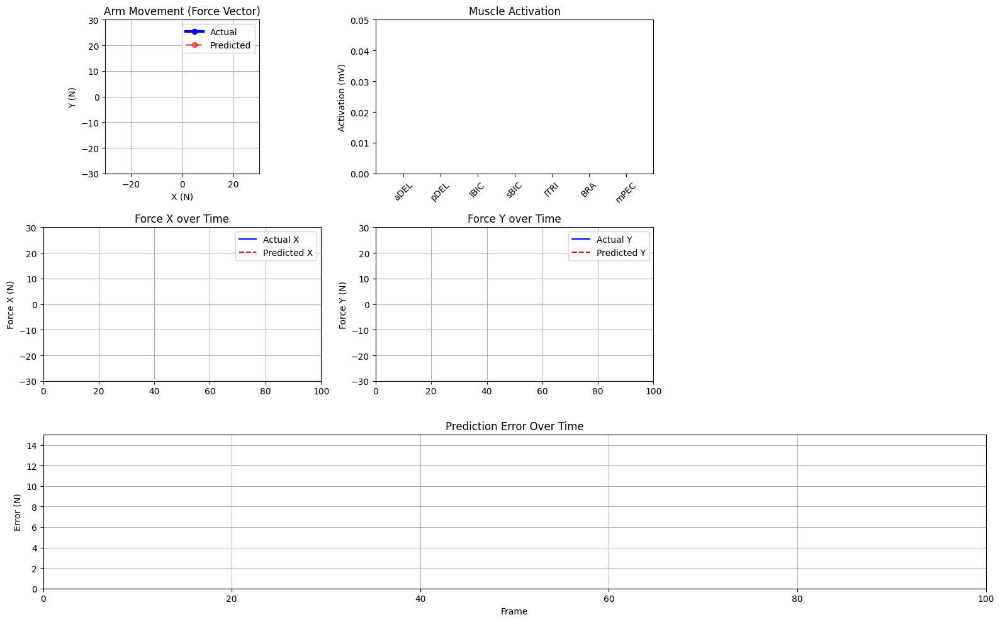

Animation size has reached 20974359 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


In [ ]:
import matplotlib.animation as animation
from IPython.display import HTML

# Initialize muscle and force data
muscle_columns = ['aDEL', 'pDEL', 'lBIC', 'sBIC', 'lTRI', 'BRA', 'mPEC']
force_columns = ['force_x', 'force_y']
best_model_name = min(model_results.items(), key=lambda x: x[1]["RMSE"])[0]
best_predictions = model_results[best_model_name]['predictions']

test_data = merged_df[merged_df['repetition'] == last_rep]
actual_force = test_data[force_columns].values
muscle_data = test_data[muscle_columns].values
pred_force = best_predictions

# Set up animation figure and axes
fig = plt.figure(figsize=(16, 10))
gs = fig.add_gridspec(3, 3)

# Arm movement (force vector from origin)
ax0 = fig.add_subplot(gs[0, 0])
ax0.set_xlim(-30, 30)
ax0.set_ylim(-30, 30)
ax0.set_aspect('equal')
ax0.set_title('Arm Movement (Force Vector)')
ax0.set_xlabel('X (N)')
ax0.set_ylabel('Y (N)')
ax0.grid(True)
arm_line_actual, = ax0.plot([], [], 'bo-', lw=3, label='Actual')
arm_line_pred, = ax0.plot([], [], 'ro--', lw=2, alpha=0.6, label='Predicted')
ax0.legend()

# Muscle activation bars
ax1 = fig.add_subplot(gs[0, 1])
bar_positions = np.arange(len(muscle_columns))
bars = ax1.bar(bar_positions, np.zeros(len(muscle_columns)), color='skyblue')
ax1.set_ylim(0, 0.05)
ax1.set_xticks(bar_positions)
ax1.set_xticklabels(muscle_columns, rotation=45)
ax1.set_title('Muscle Activation')
ax1.set_ylabel('Activation (mV)')

# Force X over time
ax2 = fig.add_subplot(gs[1, 0])
line_fx_actual, = ax2.plot([], [], 'b-', label='Actual X')
line_fx_pred, = ax2.plot([], [], 'r--', label='Predicted X')
ax2.set_xlim(0, 100)
ax2.set_ylim(-30, 30)
ax2.set_title('Force X over Time')
ax2.set_ylabel('Force X (N)')
ax2.legend()
ax2.grid(True)

# Force Y over time
ax3 = fig.add_subplot(gs[1, 1])
line_fy_actual, = ax3.plot([], [], 'b-', label='Actual Y')
line_fy_pred, = ax3.plot([], [], 'r--', label='Predicted Y')
ax3.set_xlim(0, 100)
ax3.set_ylim(-30, 30)
ax3.set_title('Force Y over Time')
ax3.set_ylabel('Force Y (N)')
ax3.legend()
ax3.grid(True)

# Error plot
ax4 = fig.add_subplot(gs[2, :])
line_err, = ax4.plot([], [], 'g-')
ax4.set_xlim(0, 100)
ax4.set_ylim(0, 15)
ax4.set_title('Prediction Error Over Time')
ax4.set_ylabel('Error (N)')
ax4.set_xlabel('Frame')
ax4.grid(True)

# Buffers
window = 50
fx_actual_buf, fx_pred_buf = [], []
fy_actual_buf, fy_pred_buf = [], []
error_buf = []

# Update function
def update(frame):
    fx_a, fy_a = actual_force[frame]
    fx_p, fy_p = pred_force[frame]
    activation = muscle_data[frame]

    # Arm movement vectors
    arm_line_actual.set_data([0, fx_a], [0, fy_a])
    arm_line_pred.set_data([0, fx_p], [0, fy_p])

    # Muscle activation
    for bar, val in zip(bars, activation):
        bar.set_height(val)

    # Update force buffers
    fx_actual_buf.append(fx_a)
    fx_pred_buf.append(fx_p)
    fy_actual_buf.append(fy_a)
    fy_pred_buf.append(fy_p)
    error_buf.append(np.linalg.norm([fx_a - fx_p, fy_a - fy_p]))

    for buf in [fx_actual_buf, fx_pred_buf, fy_actual_buf, fy_pred_buf, error_buf]:
        if len(buf) > window:
            del buf[0]

    line_fx_actual.set_data(range(len(fx_actual_buf)), fx_actual_buf)
    line_fx_pred.set_data(range(len(fx_pred_buf)), fx_pred_buf)
    line_fy_actual.set_data(range(len(fy_actual_buf)), fy_actual_buf)
    line_fy_pred.set_data(range(len(fy_pred_buf)), fy_pred_buf)
    line_err.set_data(range(len(error_buf)), error_buf)

    # Return all artists as a list
    return list(bars) + [arm_line_actual, arm_line_pred, line_fx_actual, line_fx_pred, line_fy_actual, line_fy_pred, line_err]

ani = animation.FuncAnimation(fig, update, frames=len(actual_force), interval=400, blit=False)
plt.tight_layout()
plt.show()
plt.close(fig)
HTML(ani.to_jshtml())



- **Top-left vector plot**: Shows instantaneous force direction, with actual (blue) and predicted (red) vectors overlaid - mostly capturing a downward-leftward force where prediction closely matches actual force.

- **Top-right muscle activation**: Bar chart reveals which muscles are currently active, with short head biceps (sBIC) and brachialis (BRA) showing highest activation during this specific movement phase. The triceps and deltoids which were the ost important muscles for our predictions, have a lower activation. This doesn't go against the previous results as it seems: the fact that other muscles are more active means that the least active ones are often the ones that make the difference.

- **Middle time-series plots**: Track X and Y force components over time, revealing excellent tracking accuracy for horizontal force (X) with minimal deviation between actual and predicted lines, while vertical force (Y) shows more prediction challenges.

- **Bottom error plot**: Monitors prediction accuracy over time, showing initial high error that improves as the movement progresses, with occasional spikes during transition phases.